## Import package

In [ ]:
# !pip3 install neurite
# install voxelmorph, which will also install dependencies: neurite and pystrum
!pip install voxelmorph > /dev/null
 
%cd "/content/drive/MyDrive/Colab Notebooks/Radiology/MSK-Image-Registration"
!ls

/content/drive/MyDrive/Colab Notebooks/Radiology/MSK-Image-Registration
 affineRegNN5_data3.ipynb	  ImageReg.ipynb   requirements.txt
 affine_training_data_gen.ipynb   layers.py	   utils.py
 archived_notebook		  model_img	  'VoxelMorph Demo.ipynb'
 checkpoints			  MRNet		   vxm_data_gen.ipynb
 data				  __pycache__


In [ ]:
import os
import os.path as osp
import csv
import numpy as np
import matplotlib.pyplot as plt
# import scipy
import time
from tqdm.notebook import tqdm
import pickle
import random
from termcolor import colored
import h5py, json # for load_voxelmorph

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau

# local imports for voxelmorph
import voxelmorph as vxm   # deep-learning based registration library
import neurite as ne       # medical image analysis with tensorflow

import layers as custom_layers

assert tf.__version__.startswith('2.'), 'This tutorial assumes Tensorflow 2.0+'

def color_print(string:str, color:str = "red"):
    print(colored(string, color))

def load_pickle(result_path):
    with open(result_path, "rb") as fin:
        return pickle.load(fin)

In [ ]:
# We renamed cusolver64_11.dll to cusolver64_10.dll to solve the compatibility issue.
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

# from tensorflow.python.client import device_lib
# print(device_lib.list_local_devices())

Num GPUs Available:  1


## Data path and Affine module dataloader
dataloader for training the Transformation module

- A: real image
- B: randomly affinely transformed A
- C: real image
- D: randomly affinely transformed C

affine transformation module: A&B, C&D. 

Voxelmorph: A&C,B&D 

In [75]:
## Define dataset path
trainDataPath = "./data/affineTrainingData3/train/" #affine{}.npz
valDataPath = "./data/affineTrainingData3/val/"
testDataPath = "./data/affineTrainingData3/test/"
val_size = 300 # 650
test_size = 300 # 600
fixed_input_shape = (1, 64, 256, 256, 2)


train_path_list = os.listdir(trainDataPath)
train_path_list = [os.path.join(trainDataPath, item) for item in train_path_list]
val_path_list = os.listdir(valDataPath)
val_path_list = [os.path.join(valDataPath, item) for item in val_path_list]
val_path_list = val_path_list[:val_size]
test_path_list = os.listdir(testDataPath)
test_path_list = [os.path.join(testDataPath, item) for item in test_path_list]
test_path_list = test_path_list[:test_size]

len(train_path_list), len(val_path_list), len(test_path_list)

(5000, 300, 300)

In [ ]:
batch_size = 1

In [76]:
class msk_dataset:
    """ a wraper over tf.data.Dataset """
    def __init__(self, input_path_list:list, batch_size:int, gt_trf_key="trf", train=True):
        """ 
        Dataset for knee image registration
        Args: 
            gt_trf_key:  "trf" or "trf_21param"
        Yield:
            ([movingImg, fixedImg], [fixedImg, tgtAffineTrf])
        """
        assert batch_size > 0
        self.gt_trf_key = gt_trf_key
        self.input_path_list = input_path_list
        self.length = len(input_path_list)
        self.train = train

        print(f"Init dataset, trf key: {gt_trf_key}, len {self.length}")

        if gt_trf_key == "trf":
            dataset = tf.data.Dataset.from_generator(
                self.data_generator_for_trf, 
                output_signature=(tf.TensorSpec(shape=(64, 256, 256, 2), dtype=tf.float32),
                                  (tf.TensorSpec(shape=(64, 256, 256, 1), dtype=tf.float32),
                                   tf.TensorSpec(shape=(12), dtype=tf.float32))
                                 ),
                ) # args=(input_path_list,)
        elif gt_trf_key == "trf_21param":
            dataset = tf.data.Dataset.from_generator(
                self.data_generator_for_trf_21param, 
                output_signature=(tf.TensorSpec(shape=(64, 256, 256, 2), dtype=tf.float32),
                                  (tf.TensorSpec(shape=(64, 256, 256, 1), dtype=tf.float32),
                                   tf.TensorSpec(shape=(21), dtype=tf.float32))
                                 ))
        else:
            raise ValueError("Unknown gt_trf_key/gt affine transformation format")

        dataset = dataset.batch(batch_size, drop_remainder=False, num_parallel_calls=tf.data.AUTOTUNE, 
                                deterministic=False)
        dataset = dataset.prefetch(tf.data.AUTOTUNE)
        self.dataset = dataset
        print(dataset.element_spec)
        
    def get_dataset(self):
        return self.dataset

    def data_generator_for_trf(self):
        """ The data loader for regular trf """
        ind_list = np.arange(self.length)
        while True:
            if self.train:
                ind_list = np.random.permutation(self.length)
            for i in ind_list:
                inputObj = np.load(self.input_path_list[i])
                fixedImg = inputObj["fixedImg"].astype("float32")
                movingImg = inputObj["movingImg"].astype("float32")
                imgPair = np.concatenate([movingImg, fixedImg], axis=4)
                tgtAffineTrf = inputObj["trf"].astype("float32")

                # print(imgPair.dtype, fixedImg.dtype, movingImg.dtype, tgtAffineTrf.dtype)
                # print(self.input_path_list[i])
                yield (imgPair[0], (fixedImg[0], tgtAffineTrf[0]))

    def data_generator_for_trf_21param(self):
        """ The data loader for trf_21param """
        ind_list = np.arange(self.length)
        while True:
            if self.train:
                ind_list = np.random.permutation(self.length)
            for i in ind_list:
                inputObj = np.load(self.input_path_list[i])
                fixedImg = inputObj["fixedImg"].astype("float32")
                movingImg = inputObj["movingImg"].astype("float32")
                imgPair = np.concatenate([movingImg, fixedImg], axis=4) 
                tgtAffineTrf = inputObj["trf_21param"].astype("float32") # [1, 21]
                
                yield (imgPair[0], (fixedImg[0], tgtAffineTrf[0]))

In [ ]:
# train_dataset = msk_dataset(train_path_list, batch_size).get_dataset()
# val_dataset = msk_dataset(val_path_list, batch_size).get_dataset()
# test_dataset = msk_dataset(test_path_list, batch_size, train=False).get_dataset()

train_dataset = msk_dataset(train_path_list, batch_size, gt_trf_key="trf_21param").get_dataset()
val_dataset = msk_dataset(val_path_list, batch_size, gt_trf_key="trf_21param").get_dataset() # allow some randomness in val set
test_dataset = msk_dataset(test_path_list, batch_size, gt_trf_key="trf_21param", train=False).get_dataset()

Init dataset, trf key: trf_21param, len 5000
(TensorSpec(shape=(None, 64, 256, 256, 2), dtype=tf.float32, name=None), (TensorSpec(shape=(None, 64, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 21), dtype=tf.float32, name=None)))
Init dataset, trf key: trf_21param, len 300
(TensorSpec(shape=(None, 64, 256, 256, 2), dtype=tf.float32, name=None), (TensorSpec(shape=(None, 64, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 21), dtype=tf.float32, name=None)))
Init dataset, trf key: trf_21param, len 600
(TensorSpec(shape=(None, 64, 256, 256, 2), dtype=tf.float32, name=None), (TensorSpec(shape=(None, 64, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 21), dtype=tf.float32, name=None)))


In [ ]:
# ## check dataset
# # c_dataset = msk_dataset(test_path_list, 4).get_dataset()
# c_dataset = msk_dataset(test_path_list, 2, gt_trf_key="trf_21param").get_dataset()
# ele = next(iter(c_dataset))

# print(ele[0].shape, ele[0].dtype) 
# print(ele[1][0].shape, ele[1][0].dtype, "|", ele[1][1].shape, ele[1][1].dtype)

Init dataset, trf key: trf_21param, len 600
(TensorSpec(shape=(None, 64, 256, 256, 2), dtype=tf.float32, name=None), (TensorSpec(shape=(None, 64, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 21), dtype=tf.float32, name=None)))
(2, 64, 256, 256, 2) <dtype: 'float32'>
(2, 64, 256, 256, 1) <dtype: 'float32'> | (2, 21) <dtype: 'float32'>


## Affine Transformation Module
* Input: = image pair [moving_images, fixed_images], shape:   [batch, depth, vertical, horizontal, 2]
* output: = [moved_image_tensor, affine transformation parameter]

### Model Summary & plot

In [ ]:
testModel.summary(line_length=150)

Model: "DLIR2_21param"
______________________________________________________________________________________________________________________________________________________
 Layer (type)                                    Output Shape                     Param #           Connected to                                      
 input_1 (InputLayer)                            [(None, 64, 256, 256, 2)]        0                 []                                                
                                                                                                                                                      
 sequential (Sequential)                         (None, 1024)                     16205216          ['input_1[0][0]']                                 
                                                                                                                                                      
 dense (Dense)                                   (None, 1024)          

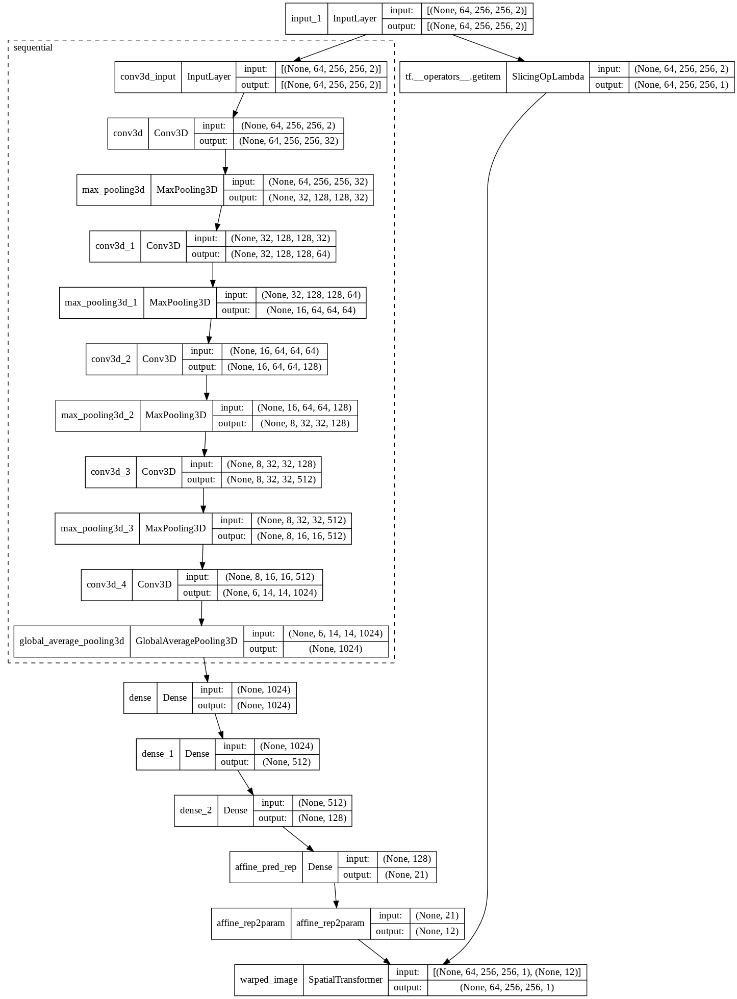

In [ ]:
keras.utils.plot_model(testModel, "./model_img/affine_module.png", show_shapes=True, expand_nested=True,)

### Layer definition

In [28]:
## Custom tf layer to convert separate affine parameters to the standard 12 params
#  tf layer tutorial: https://www.tensorflow.org/guide/keras/custom_layers_and_models#privileged_training_argument_in_the_call_method
class affine_rep2param(layers.Layer):
    """
    A custom layer to convert 21 affine transformation parameters
    to the 12 affine transformation parameters
    """
    def __init__(self, name="affine_rep2param", **kwargs):
        """
        arg:
            name
        """
        if name not in kwargs:
            kwargs.update({
                "trainable":False,
                "name":name,
            })
        super(self.__class__, self).__init__(**kwargs)
        self.rep_length = 21 

        # layer var, use Variable since tensor cannot do item assignment
        self.shearX_M = tf.Variable(initial_value=tf.eye(3), trainable=False, name=f"{self.name}/shearX_M")
        self.shearY_M = tf.Variable(initial_value=tf.eye(3), trainable=False, name=f"{self.name}/shearY_M")
        self.shearZ_M = tf.Variable(initial_value=tf.eye(3), trainable=False, name=f"{self.name}/shearZ_M")
    
    def build(self, input_shape):
        assert input_shape[1] == self.rep_length
        self.built = True
    
    def get_config(self):
        config = super().get_config().copy()
        return config
    
    def call(self, input, training=True):
        assert input.shape[1] == self.rep_length

        # convert affine rep to 12 params of affine transformation matrix
        if training: # have to separate the two cases since fn should only accepts one input
            return tf.map_fn(self.single_rep2param, input, fn_output_signature=tf.float32)#, parallel_iterations=batch_size)
        else: # using symmetric_orthogonalization
            return tf.map_fn(self.single_rep2param_svd, input, fn_output_signature=tf.float32)#, parallel_iterations=batch_size)
      
    def single_rep2param(self, rep):
        """
        convert a single affine representation of length-21 tensors to 
        affine parameters of length-12 tensors
        Args:
            rep: 21 param [21]
        """
        trans, rot, shear, scale = rep[0:3], rep[3:12], rep[12:18], rep[18:21]
        # affine_param = K.variable(lambda : K.ones((3,4))) # lambda for variable(): https://stackoverflow.com/questions/61579678/valueerror-tensor-typed-variable-initializers-must-either-be-wrapped-in-an-init
        # affine_param = affine_param[:, 3].assign(trans) # assign: https://stackoverflow.com/questions/57454529/how-to-assign-a-value-to-the-tensor-object-in-keras

        self.shearX_M[1:3, 0].assign(shear[:2])
        self.shearY_M[0, 1].assign(shear[2])
        self.shearY_M[2, 1].assign(shear[3])
        self.shearZ_M[0:2, 2].assign(shear[4:])
        affine_param = self.shearX_M @ self.shearY_M @ self.shearZ_M * scale

        affine_param = K.reshape(rot, (3,3)) @ affine_param
        affine_param = tf.concat([affine_param, trans[:, None]], axis = 1)
        return K.reshape(affine_param, shape=[-1])

    def single_rep2param_svd(self, rep):
        """
        convert a single affine representation of length-18 tensors to 
        affine parameters of length-12 tensors using symmetric_orthogonalization:
        https://github.com/google-research/google-research/tree/master/special_orthogonalization 
        """
        trans, rot, shear, scale = rep[0:3], rep[3:12], rep[12:18], rep[18:21]

        self.shearX_M[1:3, 0].assign(shear[:2])
        self.shearY_M[0, 1].assign(shear[2])
        self.shearY_M[2, 1].assign(shear[3])
        self.shearZ_M[0:2, 2].assign(shear[4:])
        affine_param = self.shearX_M @ self.shearY_M @ self.shearZ_M * scale

        ## symmetric orthogonalization
        rot = K.reshape(rot, (3,3))
        s,u,v = tf.linalg.svd(rot)
        vt = tf.transpose(tf.math.conj(v))
        det = tf.linalg.det(u @ vt)
        vt = tf.concat((vt[:2, :], vt[-1:, :] * det), axis=0) # flip last row if det=-1
        rot = u @ vt

        affine_param = rot @ affine_param
        affine_param = tf.concat([affine_param, trans[:, None]], axis = 1)
        return K.reshape(affine_param, shape=[-1])

In [29]:
## check 
# affine_pred = affine_rep2param(name="affine_rep2param")

### Load pretrained affine module & Evaluate Model

In [30]:
def evaluate_model(testModel, dataGen, num=20):
    """
    Evaluate the affine param difference and image mse.
    """
    scores = []
    mses = []
    for _ in tqdm(range(num)):
        moving_test, label_test = next(dataGen)
        gt_trf = label_test[1].numpy()
        warped_test, affine_pred_test = testModel(moving_test, training=False) # inference mode
        diff = np.abs(gt_trf - affine_pred_test.numpy())
        scores.append(diff)
        mse = ((warped_test[:,..., 0].numpy() - moving_test[:,..., 1].numpy())**2).mean()
        mses.append(mse)
    scores = np.mean(scores, axis=0) # mean of samples
    mses = np.mean(mses)
    if len(scores.shape) >=2:
        scores = np.mean(scores, axis=0) # mean of batches
    return{
#        "trans": scores[0:3].mean(),
#        "rot": scores[3:12].mean(),
#        "scale": scores[12:15].mean(),
#        "shear": scores[15:18].mean(),
        "tsf_param_mse": scores.mean(),
        "img_mse": mses,
    }

def plot_single_3D_image(path, testModel, gt_trf_key="trf", slice_to_begin=20, slice_num_show=10, slice_interval=2, compare_trf=False):
    """
    Visualize a single 3D scan image.
    Used mostly to select image as input for plot_two_3D_image_as_fixed_and_moving
    """
    inputObj = np.load(path)
    fixed_img = inputObj["fixedImg"].astype("float32")
    movingImg = inputObj["movingImg"].astype("float32")
    gt_trf = inputObj[gt_trf_key].astype("float32")
    moving_test = np.concatenate([movingImg, fixed_img], axis=4)

    (warped_test, affine_pred_test) = testModel(moving_test, training=False) # inference mode
    warped_test = warped_test.numpy()

    mse = ((fixed_img - warped_test)**2).mean()
    print("Sample: ", path)
    print("Sample mse:", mse)
    print((f" --- Sample {os.path.basename(path)}, slice {slice_to_begin} ~ {slice_to_begin}+{slice_interval}*{slice_num_show}"))

    fig, axes = plt.subplots(slice_num_show, 3, figsize=(10,3*slice_num_show))
    for j in range(slice_num_show):
        axes[j,0].imshow(fixed_img[0,slice_to_begin + j * slice_interval,:,:,0]) # F
        axes[j,1].imshow(moving_test[0,slice_to_begin + j * slice_interval,:,:,0])   # M
        axes[j,2].imshow(warped_test[0,slice_to_begin + j * slice_interval,:,:,0])
    axes[0,0].set_title("Fixed")
    axes[0,1].set_title("Moving")
    axes[0,2].set_title("Wrapped")
    plt.tight_layout()
    plt.show()

    if compare_trf:
        np.set_printoptions(suppress=True, precision=4)
        print(gt_trf.round(3).reshape(-1))
        print("------------------")
        print(affine_pred_test.numpy().round(3).reshape(-1))
        print("------------------")

def plot_two_3D_image_as_fixed_and_moving(fixed_path, moving_path, testModel, gt_trf_key="trf", 
                                          slice_to_begin=20, slice_num_show=10, slice_interval=2, compare_trf=False):
    """
    Test and visualize on a pair of images coming from different real images
    arg:
        testModel: loaded testModel
        gt_trf_key: string to the transformation matrix/representation
        slice_to_begin: starting slice
        slice_num_show: # of slice shwon
        compare_trf: whether to show trf comparison
    """
    inputObj = np.load(fixed_path)
    fixed_img = inputObj["fixedImg"].astype("float32")
    inputObj = np.load(moving_path)
    movingImg = inputObj["movingImg"].astype("float32")
    gt_trf = inputObj[gt_trf_key].astype("float32")
    
    # get wrapped img
    moving_test = np.concatenate([movingImg, fixed_img], axis=4)
    (warped_test, affine_pred_test) = testModel(moving_test, training=False) # inference mode
    warped_test = warped_test.numpy()
    mse = ((fixed_img - warped_test)**2).mean()

    moving_test2 = np.concatenate([movingImg[:,:,:,::-1], fixed_img], axis=4)
    (warped_test2, affine_pred_test2) = testModel(moving_test2, training=False) # inference mode
    warped_test2 = warped_test2.numpy()
    mse2 = ((fixed_img - warped_test2)**2).mean()
    print(f"mse1: {mse}, mse2: {mse2}")

    # compare mse score with fliping V.S. w/o fliping
    if mse2 < mse: # flipping initial moving image is better
        mse = mse2
        warped_test = warped_test2
        affine_pred_test = affine_pred_test2
        print("flipping initial moving img")

    # print("Sample: ", fixed_path, moving_path)
    ori_mse = ((fixed_img - movingImg)**2).mean()
    print(f"Sample initial mse: {ori_mse}, output mse: {mse}")
    # print((f" --- Sample {os.path.basename(path)}, slice {slice_to_begin} ~ {slice_to_begin}+{slice_interval}*{slice_num_show}"))

    fig, axes = plt.subplots(slice_num_show, 3, figsize=(10,3*slice_num_show))
    for j in range(slice_num_show):
        axes[j,0].imshow(fixed_img[0,slice_to_begin + j * slice_interval,:,:,0]) # F
        axes[j,1].imshow(movingImg[0,slice_to_begin + j * slice_interval,:,:,0])   # M
        axes[j,2].imshow(warped_test[0,slice_to_begin + j * slice_interval,:,:,0])
    axes[0,0].set_title("Fixed")
    axes[0,1].set_title("Moving")
    axes[0,2].set_title("Wrapped")
    plt.tight_layout()
    plt.show()

    if compare_trf:
        np.set_printoptions(suppress=True, precision=4)
        print(gt_trf.round(3).reshape(-1))
        print("------------------")
        print(affine_pred_test.numpy().round(3).reshape(-1))
        print("------------------")

In [31]:
# Load model from experiment DLIR_2_21param_T5
affine_mdl_path = "checkpoints/DLIR_2_dataV3_21param/11_23_13-36-50/115.h5"
testModel = keras.models.load_model(affine_mdl_path, custom_objects=
                {"SpatialTransformer":custom_layers.SpatialTransformer, # (interp_method='linear', add_identity=False, name="warped_image", shift_center=True)
                "affine_rep2param":affine_rep2param,
            })
affine_model = testModel

In [ ]:
steps = test_size//batch_size
testModel.evaluate(x=test_dataset, steps=steps, return_dict=True)

300/300 [==============================] - 648s 2s/step - loss: 0.0986 - warped_image_loss: 0.0085 - affine_pred_rep_loss: 0.0647


{'affine_pred_rep_loss': 0.06474021822214127,
 'loss': 0.09863585978746414,
 'warped_image_loss': 0.00847390666604042}

In [ ]:
iterator = iter(msk_dataset(test_path_list, batch_size, gt_trf_key="trf_21param", train=True).get_dataset())
moving_test, label_test = next(iterator)
moving_test = moving_test[:, 16:48, :128, :128,:]
moving_test.shape

Init dataset, trf key: trf_21param, len 100
(TensorSpec(shape=(None, 64, 256, 256, 2), dtype=tf.float32, name=None), (TensorSpec(shape=(None, 64, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 21), dtype=tf.float32, name=None)))


TensorShape([1, 32, 128, 128, 2])

In [ ]:
# cannot work for another size
affine_model.inputs = keras.Input(shape = (32,128,128,2))
affine_model(moving_test, training=False)

TypeError: ignored

### Result Visualization

In [ ]:
iterator = iter(msk_dataset(test_path_list, batch_size, gt_trf_key="trf_21param", train=True).get_dataset())
%timeit moving_test, label_test = next(iterator)
print()
%timeit moving_test, label_test = next(iterator);(warped_test, affine_pred_test) = testModel(moving_test, training=False) # inference mode

Init dataset, trf key: trf_21param, len 100
(TensorSpec(shape=(None, 64, 256, 256, 2), dtype=tf.float32, name=None), (TensorSpec(shape=(None, 64, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 21), dtype=tf.float32, name=None)))
1 loop, best of 5: 289 ms per loop

1 loop, best of 5: 756 ms per loop


In [ ]:
## Visualize model output
iterator = iter(msk_dataset(test_path_list, batch_size, gt_trf_key="trf_21param", train=True).get_dataset())
moving_test, label_test = next(iterator)
num_show = 2
slice_num_show = 10 # >1
slice_interval = 2
moving_test, gt_trf = moving_test[:num_show], label_test[1][:num_show]
(warped_test, affine_pred_test) = testModel(moving_test, training=False) # inference mode

fixed_img = label_test[0].numpy()
gt_trf = gt_trf.numpy()

sliceToCheck = 20
for i in range(num_show):
    mse = ((fixed_img[i] - warped_test[i].numpy())**2).mean()
    print("Sample mse:", mse)
    print((f"  Sample {i}, slice {sliceToCheck} ~ {sliceToCheck}+{slice_interval}*{slice_num_show}"))

    fig, axes = plt.subplots(slice_num_show,3, figsize=(10,3*slice_num_show))
    for j in range(slice_num_show):
        # axes[j,1].imshow(fixedImg[0,sliceToCheck + j * slice_interval,...,0])   # M
        axes[j,0].imshow(fixed_img[i,sliceToCheck + j * slice_interval,:,:,0]) # F
        axes[j,1].imshow(moving_test[i,sliceToCheck + j * slice_interval,:,:,0])   # M
        axes[j,2].imshow(warped_test[i,sliceToCheck + j * slice_interval,:,:,0])
    axes[0,0].set_title("Fixed")
    axes[0,1].set_title("Moving")
    axes[0,2].set_title("Wrapped")
    plt.tight_layout()
    plt.show()
    print("------------------")

# print(["{:f.3}".format(x) for x in gt_trf])
np.set_printoptions(suppress=True, precision=4)
print(gt_trf.round(3).reshape(-1))
print("------------------")
print(affine_pred_test.numpy().round(3).reshape(-1))
print("------------------")

Output hidden; open in https://colab.research.google.com to view.

mse1: 0.0018550975946709514, mse2: 0.019055670127272606
Sample mse: 0.0018550976


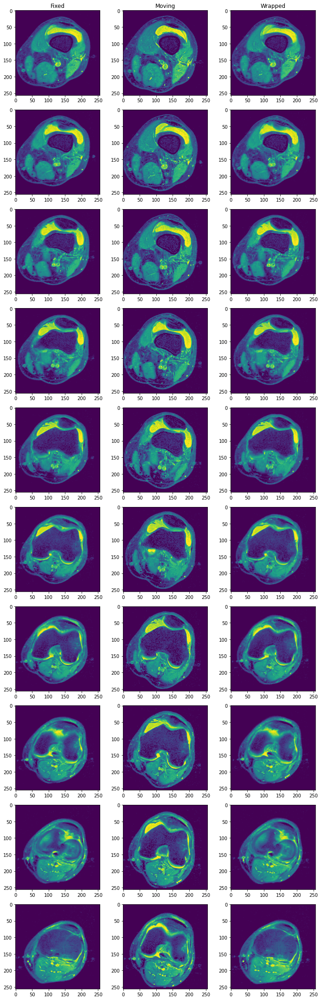

[ 0.096 22.221  0.     0.999 -0.018 -0.03   0.02   0.999  0.043  0.029
 -0.043  0.999  0.018  0.013  0.033  0.002  0.02   0.024  1.022  0.85
  1.089]
------------------
[ 3.693  5.842  0.013  1.007 -0.041 -0.046  0.028  1.008  0.052  0.047
 -0.066  1.002  0.029  0.03   0.019  0.032  0.034  0.023  1.155  1.087
  1.009]
------------------


In [ ]:
# test on two different image (0-4, 5-9,.. are from the same)
path1 = test_path_list[0]
path2 = test_path_list[4]
plot_two_3D_image_as_fixed_and_moving(path1, path2, testModel=affine_model, gt_trf_key="trf_21param", 
                   slice_to_begin=20, slice_num_show=10, slice_interval=2, compare_trf=True)

./data/affineTrainingData3/test/affine_18_0.npz ./data/affineTrainingData3/test/affine_9_2.npz
mse1: 0.039231833070516586, mse2: 0.05100297927856445
Sample initial mse: 0.06385213136672974, output mse: 0.039231833070516586


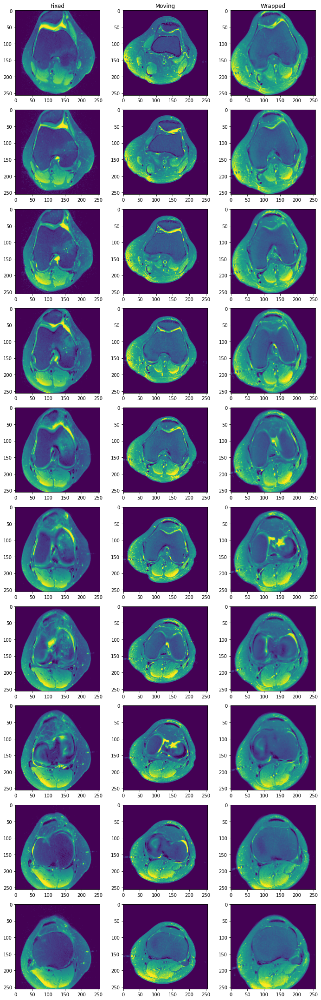

[ 0.778 16.821  0.     0.999 -0.015 -0.032  0.02   0.989  0.144  0.03
 -0.145  0.989  0.038  0.016  0.037  0.041  0.029  0.037  0.953  0.887
  1.12 ]
------------------
[ 3.1    3.773 -0.014  1.022 -0.023 -0.018  0.027  0.973  0.243  0.017
 -0.206  1.011  0.011  0.05   0.003 -0.015  0.027 -0.006  0.702  0.768
  0.903]
------------------


In [ ]:
## test on two different image (0-4, 5-9,.. are from the same)
path1, path2 = np.random.choice(test_path_list, size=2, replace=False)
print(path1, path2)
plot_two_3D_image_as_fixed_and_moving(path1, path2, testModel=affine_model, gt_trf_key="trf_21param", 
                   slice_to_begin=20, slice_num_show=10, slice_interval=2, compare_trf=True)

### Visualize image

In [ ]:
# path = sorted(train_path_list)[5]
path = './data/affineTrainingData3/train/affine_14_0.npz'

Sample:  ./data/affineTrainingData3/train/affine_12_0.npz
Sample mse: 0.010518374
 --- Sample affine_12_0.npz, slice 20 ~ 20+2*4


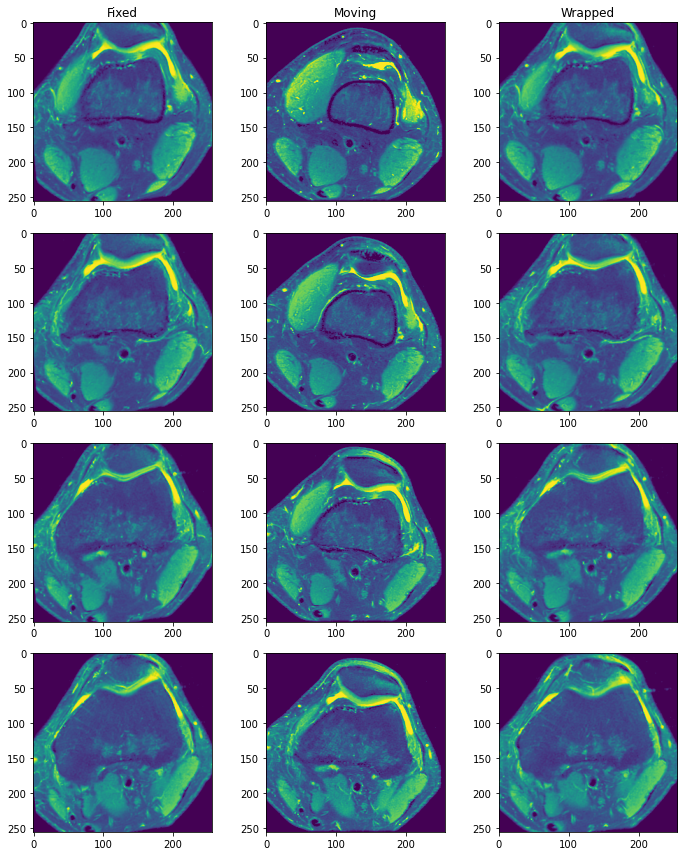

In [ ]:
plot_single_3D_image(path, testModel, gt_trf_key="trf", slice_to_begin=20, slice_num_show=4, slice_interval=2, compare_trf=False)

## VoxelMorph non-affigned deformation Module

* Input: = [moving_images, fixed_images]
* output: = [moved_image_tensor, disp_tensor]
* eg in 2D:
    * input shape:  (None, 32, 32, 1), (None, 32, 32, 1)
    * output shape: (None, 32, 32, 1), (None, 32, 32, 2)


VoxelMorph tutorial: https://colab.research.google.com/drive/1WiqyF7dCdnNBIANEY80Pxw_mVz4fyV-S?usp=sharing#scrollTo=io8onq5mPXPa

In [79]:
def load_voxelmorph(vxm_model_weight_path, inshape=None):
    """
    Load the VoxelMorph model from a weight path

    The original `vxm.networks.VxmDense.load` in the library has bugs.
    Changes: 
        1. remove .decode
        2. allow input shape to be changed 
        3. pop "name" key in order to load trained SynthMorph weight
    This methods is modified from it:
    "/usr/local/lib/python3.7/dist-packages/voxelmorph/tf/modelio.py" 
    """
    with h5py.File(vxm_model_weight_path, mode='r') as f:
        # print(f.attrs['model_config'])
        config = json.loads(f.attrs['model_config'])['config']

    # provide a temporary backport for the old-school enc_nf/dec_nf constructor params
    if config.get('enc_nf') and config.get('dec_nf'):
        config['nb_unet_features'] = [
            config.pop('enc_nf'),
            config.pop('dec_nf')
        ]

    if inshape: # if the inshape for trained model is different
        config["inshape"] = inshape
    if "name" in config:
        config.pop("name")
    if "fill_value" in config:
        config.pop("fill_value")
    vxm_model = vxm.networks.VxmDense(**config)
    vxm_model.load_weights(vxm_model_weight_path, by_name=False)
    return vxm_model


def MSE(img1, img2):
    """ return MSE over all voxel of img in np.array"""
    return ((img1 - img2)**2).mean()

def affinely_wrap_img(affine_model, moving_test, fixed_img, vis=False, debug=False):
    """
    Predict the affinely wrapped image with the pretrained affine transformation 
    model. Horizontally flip the wrapped img if that has better MSE.
    Only consider hflip since it makes sence for knee MRI
    args:
        testModel: pretrained affine transformation model
        moving_test: input to the affine transformation model, [1, 64, 256, 256, 2] 
        fixed_img: the original img to be aligned with, [1, 64, 256, 256, 1]
    """
    # (warped_test, affine_pred_test) = affine_model(moving_test, training=False) # inference mode
    (warped_test, _) = affine_model(moving_test, training=False) # inference mode
    warped_test = warped_test.numpy()
    # mse = ((fixed_img - warped_test)**2).mean()
    mse = MSE(fixed_img, warped_test)

    # try the flipped moving img
    moving_test2 = np.concatenate([moving_test[:,:,:,::-1, 0:1], fixed_img], axis=4) # flip moving in x
    (warped_test2, _) = affine_model(moving_test2, training=False) # inference mode
    warped_test2 = warped_test2.numpy()
    mse2 = MSE(fixed_img, warped_test2)
    if debug:
        print(f"mse1: {mse}, mse2: {mse2}")

    if vis:
        fixed_img_ = fixed_img[0, ... ,0]
        moving_test_ = moving_test[0, ... ,0]
        moving_test2_ = moving_test2[0, ... ,0]
        assert moving_test_.shape == (64,256,256)
        plt.imshow(fixed_img_[32])
        plt.show()
        plt.imshow(moving_test_[32])
        plt.show()
        plt.imshow(moving_test2_[32])
        plt.show()

    # compare mse score with fliping V.S. w/o fliping
    if mse2 < mse: # flipping initial moving image is better
        warped_test = warped_test2
        # affine_pred_test = affine_pred_test2
        # print("flipping initial moving img")

    return warped_test

def deformably_wrap_img(vxm_model, warped_img_dim5, fixed_img_dim5):
    """
    Deformably predict the wrapped image with trained VoxelMorph model.
    args:
        vxm_model: trained VoxelMorph model.
        warped_img_dim5: affinely wrapped img, [1, 64, 256, 256, 1] 
        fixed_img_dim5: the original img to be aligned with, [1, 64, 256, 256, 1]
    ret:
        moved_pred: [64, 256, 256]
        pred_disp_field: [1, 64, 256, 256, 3]
    """
    # VoxelMorph Output
    val_input = (warped_img_dim5, fixed_img_dim5)
    val_pred = vxm_model.predict(val_input)

    moved_pred = val_pred[0].squeeze() # final wrapped img
    pred_disp_field = val_pred[1] # displacement field
    return moved_pred, pred_disp_field

def cal_result_MSE(fixed_img, moving_img, warped_img=None, moved_pred=None, print_result=True):
    # print("-----------------")
    init_mse = MSE(fixed_img, moving_img)
    if warped_img is not None:
        interm_mse = MSE(fixed_img, warped_img)
    if moved_pred is not None:
        final_mse = MSE(fixed_img, moved_pred)
    if print_result:
        color_print(f"Init MSE between fixed and moving: {init_mse}", "cyan")
        if warped_img is not None:
            color_print(f"Interm. MSE between fixed and affinely wrapped: {interm_mse}", "cyan")
        if moved_pred is not None:
            color_print(f"Final MSE between fixed and deformably wrapped: {final_mse}", "cyan")
    # return init_mse, interm_mse, final_mse

def register_img_pair(fixed_path, moving_path, affine_model, vxm_model, vis=False):
    """
    Given an image pair and trained affine transformation network and trained 
    VoxelMorph model, register the image pair
    Args:
        fixed_path, moving_path: path to each image in the input image pair
        affine_model: loaded trained affine transformation model
        vxm_model: loaded trained deformable VoxelMorph model
    """
    inputObj = np.load(fixed_path)
    fixed_img = inputObj["fixedImg"].astype("float32")
    if np.max(fixed_img) > 5: # need to normalize
        fixed_img /= 255
    inputObj = np.load(moving_path)
    movingImg = inputObj["movingImg"].astype("float32")
    if np.max(movingImg) > 5: # need to normalize
        movingImg /= 255
    # gt_trf = inputObj[gt_trf_key].astype("float32")

    # Affine Transformation model output (with possible flipping)
    moving_test = np.concatenate([movingImg, fixed_img], axis=4)
    warped_test = affinely_wrap_img(testModel, moving_test, fixed_img, vis)

    fixed_img_dim5 = fixed_img
    fixed_img = fixed_img_dim5[0,...,0]
    moving_img_dim5 = movingImg
    moving_img = moving_img_dim5[0,...,0]
    warped_img_dim5 = warped_test
    warped_img = warped_img_dim5[0,...,0]
    print("After affine transformation, fixed_img:", fixed_img.shape, " movingImg:", movingImg.shape, " warped_test:", warped_test.shape)
    # ((64, 256, 256), (1, 64, 256, 256, 1), (1, 64, 256, 256, 1))

    moved_pred, pred_disp_field = deformably_wrap_img(vxm_model, warped_img_dim5, fixed_img_dim5)
    print("After deformable transformation, fixed_img:", fixed_img.shape, "moved_pred: ", moved_pred.shape, " pred_disp_field:", pred_disp_field.shape)
    # ((64, 256, 256), (1, 64, 256, 256, 3))

    return fixed_img, moving_img, warped_img, moved_pred, pred_disp_field 
    # [64, 256, 256], [64, 256, 256], [64, 256, 256],[64, 256, 256], [1, 64, 256, 256, 3]


def register_fixed_and_affinely_wrapped(fixed_path, test_path):
    """
    Given a real image and an affinely aligned moving img, register the image pair
    Args:
        fixed_path, moving_path: path to each image in the input image pair
        vxm_model: loaded trained deformable VoxelMorph model
    """
    inputObj = np.load(fixed_path)
    fixed_img = inputObj["fixedImg"].astype("float32")
    if np.max(fixed_img) > 5: # need to normalize
        fixed_img /= 255
    moving_img = inputObj["movingImg"].astype("float32")
    if np.max(moving_img) > 5: # need to normalize
        moving_img /= 255

    moved_pred, pred_disp_field = vxm_model.predict((moving_img, fixed_img))
    print("After deformable transformation, fixed_img:", fixed_img.shape, " movingImg:", moving_img.shape, "moved_pred: ", moved_pred.shape, " pred_disp_field:", pred_disp_field.shape)
    # ((64, 256, 256), (1, 64, 256, 256, 3))

    # moved_pred = moved_pred.squeeze()
    return fixed_img.squeeze(), moving_img.squeeze(), moved_pred.squeeze(), pred_disp_field.squeeze() 
    # [64, 256, 256], [64, 256, 256], [64, 256, 256], [64, 256, 256, 3]


def visualize_fixed_and_deformed(fixed_img, moved_pred):
    ## Visualize fixed & VoxelMorph warpped 3d image 
    vol_shape = fixed_img.shape
    mid_slices_fixed = [np.take(fixed_img, vol_shape[d]//2, axis=d) for d in range(3)]
    mid_slices_pred = [np.take(moved_pred, vol_shape[d]//2, axis=d) for d in range(3)]
    ne.plot.slices(mid_slices_fixed + mid_slices_pred, cmaps=['gray'], do_colorbars=True, grid=[2,3]);

def visualize_fixed_moving_affine_deformed(fixed_img, moving_img, warped_img, moved_pred, 
                                           middle_slice_list:list = [25,30,35,40]):
    ## Visualize fixed, moving, affinely warped & VoxelMorph warpped image 
    for i, middle_slice in enumerate(middle_slice_list):
    # middle_slice = 30
        slices = [fixed_img[middle_slice], moving_img[middle_slice], warped_img[middle_slice], moved_pred[middle_slice]]
        if i == 0:
            ne.plot.slices(slices, titles=["fixed", "moving", "affine", "deformable"] ,cmaps=['gray'], do_colorbars=True, grid=[1,4]);
        else:
            ne.plot.slices(slices, cmaps=['gray'], do_colorbars=True, grid=[1,4]);

def visualize_3D_image_list(img_list, middle_slice_list:list=[25,30,35,40], titles=None):
    """
    titles: list of labels for each img
    """
    img_list = [img.squeeze() for img in img_list]
    assert len(img_list) > 0 and img_list[0].shape == (64, 256, 256)
    if titles is not None:
        assert len(titles) == len(img_list)

    ## Visualize a list of img
    for i, middle_slice in enumerate(middle_slice_list):
        slices = []
        for img in img_list:
            slices.append(img[middle_slice])

        if i == 0 and titles is not None:
            ne.plot.slices(slices, titles=titles ,cmaps=['gray'], do_colorbars=True, grid=[1,len(img_list)]);
        else:
            ne.plot.slices(slices, cmaps=['gray'], do_colorbars=True, grid=[1,len(img_list)]);


def visualize_disp_field(disp_field, middle_slice=None, interval=4, width=6):
    """
    draw a middle slice for the displacement field
    args:
        disp_field: [1, 64, 256, 256, 3] or [64, 256, 256, 3]
        middle_slice: which slice to use
        interval: interval along x and y axis
        width: width of the plot
    """
    disp_field = disp_field.squeeze()
    # visualize flow
    if middle_slice is None:
        middle_slice = disp_field.shape[0]//2
    if isinstance(middle_slice, int):
        flow = disp_field[middle_slice][::interval,::interval,1:]
        ne.plot.flow([flow], width=width);
    elif isinstance(middle_slice, list):
        for single_slice in middle_slice:
            flow = disp_field[single_slice][::interval,::interval,1:]
            ne.plot.flow([flow], width=width);

### Load pretrained VoxelMorph
the standard, dense VoxelMorph archetecture, with a UNet component, displacement field, and final spatial transformer layer, for brain registration 

4 Available pretrained VoxelMorph at `checkpoints/pretrain_voxelmorph/`
* `brain_3d.h5`: 3D brain reg
    * from [MRI tutorial data](https://surfer.nmr.mgh.harvard.edu/pub/data/voxelmorph/tutorial_data.tar.gz)
* `vxm_dense_brain_T1_3D_mse.h5`: dense 3D reg
    * from github dev, [pretrained](https://github.com/voxelmorph/voxelmorph/blob/dev/data/readme.md#models)
    * Lower MSE compared to brain_3d
    * still not smooth
* `shapes-dice-vel-3-res-8-16-32-256f.h5`: SynthMorph "shape" variant trained on synthesized random shapes
    * from github dev
    * higher MSE but smoother
* `brains-dice-vel-0.5-res-16-256f.h5`: SynthMorph "brains" variant trained using images synthesized from brain label maps
    * from github dev
    * smoother than brain_T1_3D_mse, but really not responsive



In [ ]:
### Load sample weight
# configure unet features 
inshape = (64,256,256)
# nb_features = [
#     [32, 32, 32, 32],         # encoder features
#     [32, 32, 32, 32, 32, 16]  # decoder features
# ]
nb_features = [
    [16, 32, 32, 32],
    [32, 32, 32, 32, 32, 16, 16]
]

In [ ]:
# build model using VxmDense:
# vxm_model_weight_path = './checkpoints/pretrain_voxelmorph/brain_3d.h5'
vxm_model_weight_path = './checkpoints/pretrain_voxelmorph/vxm_dense_brain_T1_3D_mse.h5' # similar to brain 3d
# vxm_model_weight_path = './checkpoints/pretrain_voxelmorph/shapes-dice-vel-3-res-8-16-32-256f.h5'
# vxm_model_weight_path = './checkpoints/pretrain_voxelmorph/brains-dice-vel-0.5-res-16-256f.h5'

vxm_model = vxm.networks.VxmDense(inshape, nb_features, int_steps=0)
# vxm_model.load_weights(vxm_model_weight_path)
vxm_model = load_voxelmorph(vxm_model_weight_path, inshape)

print('input shape: ', ', '.join([str(t.shape) for t in vxm_model.inputs])) # input = pair
print('output shape:', ', '.join([str(t.shape) for t in vxm_model.outputs])) # outputs = [moved_image_tensor, disp_tensor]

input shape:  (None, 64, 256, 256, 1), (None, 64, 256, 256, 1)
output shape: (None, 64, 256, 256, 1), (None, 32, 128, 128, 3)


In [ ]:
# vxm_model2 = vxm_model

#### Scratch code from register.py

In [ ]:
## code to load weight, from register.py
## ./scripts/tf/register.py --moving moving.nii.gz --fixed atlas.nii.gz --moved warped.nii.gz --model model.h5 --gpu 0
gpu = 0
moving = test_path_list[120]
fixed = test_path_list[0]
# moved_output = ""
model_path = "./checkpoints/pretrain_voxelmorph/vxm_dense_brain_T1_3D_mse.h5"

# load moving and fixed images
moving = vxm.py.utils.load_volfile(moving, np_var="movingImg", add_batch_axis=False, add_feat_axis=False)
fixed = vxm.py.utils.load_volfile(fixed, np_var="fixedImg", add_batch_axis=False, add_feat_axis=False)
print(moving.shape, fixed.shape)

inshape = moving.shape[1:-1]
nb_feats = moving.shape[-1]

vxm_model = load_voxelmorph(model_path, inshape)
warp = vxm_model.register(moving, fixed)
transform_layer = vxm.networks.Transform(inshape, nb_feats=nb_feats)
moved = transform_layer.predict([moving, warp])
print(moved.shape)

(1, 64, 256, 256, 1) (1, 64, 256, 256, 1)
(1, 64, 256, 256, 1)


In [ ]:
# ## test load_voxelmorph
with h5py.File(vxm_model_weight_path, mode='r') as f:
    print(f.attrs['model_config'])
    # config = json.loads(f.attrs['model_config'])['config']

# # provide a temporary backport for the old-school enc_nf/dec_nf constructor params
# if config.get('enc_nf') and config.get('dec_nf'):
#     config['nb_unet_features'] = [
#         config.pop('enc_nf'),
#         config.pop('dec_nf')
#     ]

# config["inshape"] = inshape
# vxm_model = vxm.networks.VxmDense(**config)
# vxm_model.load_weights(vxm_model_weight_path, by_name=False)

{"class_name": "VxmDense", "config": {"name": "vxm_dense", "fill_value": null, "input_model": null, "unet_half_res": true, "trg_feats": 1, "src_feats": 1, "use_probs": false, "bidir": false, "int_downsize": 2, "int_steps": 10, "nb_unet_conv_per_level": 1, "unet_feat_mult": 1, "nb_unet_levels": null, "nb_unet_features": [[256, 256, 256, 256], [256, 256, 256, 256, 256, 256]], "inshape": [160, 160, 192]}}


### Test VoxelMorph on affinely wrapped image

In [ ]:
# brain_3d
fixed_path = test_path_list[0]
# moving_path = test_path_list[120]
# moving_path = test_path_list[130]
moving_path = test_path_list[150]
fixed_img, moving_img, warped_img, moved_pred, pred_disp_field = register_img_pair(fixed_path, moving_path, testModel, vxm_model)
cal_result_MSE(fixed_img, moving_img, warped_img, moved_pred)

mse1: 0.023750288411974907, mse2: 0.025362659245729446
After affine transformation, fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)
After deformable transformation, fixed_img: (64, 256, 256) moved_pred:  (64, 256, 256)  pred_disp_field: (1, 64, 256, 256, 3)
Init MSE between fixed and moving: 0.06924312561750412
Interm. MSE between fixed and affinely wrapped: 0.023750288411974907
Final MSE between fixed and deformably wrapped: 0.008301903493702412


(0.069243126, 0.023750288, 0.0083019035)

In [ ]:
# brain_T1_3D_mse
fixed_path = test_path_list[0]
# moving_path = test_path_list[120]
# moving_path = test_path_list[130]
moving_path = test_path_list[150]
fixed_img, moving_img, warped_img, moved_pred, pred_disp_field = register_img_pair(fixed_path, moving_path, testModel, vxm_model)
cal_result_MSE(fixed_img, moving_img, warped_img, moved_pred)

mse1: 0.023750288411974907, mse2: 0.025362659245729446
After affine transformation, fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)
After deformable transformation, fixed_img: (64, 256, 256) moved_pred:  (64, 256, 256)  pred_disp_field: (1, 32, 128, 128, 3)
Init MSE between fixed and moving: 0.06924312561750412
Interm. MSE between fixed and affinely wrapped: 0.023750288411974907
Final MSE between fixed and deformably wrapped: 0.0066571361385285854


(0.069243126, 0.023750288, 0.006657136)

#### test pretrained brain_T1_3D_mse

In [ ]:
# brain_T1_3D_mse
fixed_path = test_path_list[0]
moving_path = test_path_list[120]
# moving_path = test_path_list[130]
# moving_path = test_path_list[150]
fixed_img, moving_img, warped_img, moved_pred, pred_disp_field = register_img_pair(fixed_path, moving_path, testModel, vxm_model)

mse1: 0.027061885222792625, mse2: 0.030053822323679924
After affine transformation, fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)
After deformable transformation, fixed_img: (64, 256, 256) moved_pred:  (64, 256, 256)  pred_disp_field: (1, 32, 128, 128, 3)
Init MSE between fixed and moving: 0.05738130956888199
Interm. MSE between fixed and affinely wrapped: 0.027061885222792625
Final MSE between fixed and deformably wrapped: 0.007985953241586685


(0.05738131, 0.027061885, 0.007985953)

Init MSE between fixed and moving: 0.05738130956888199
Interm. MSE between fixed and affinely wrapped: 0.027061885222792625
Final MSE between fixed and deformably wrapped: 0.007985953241586685


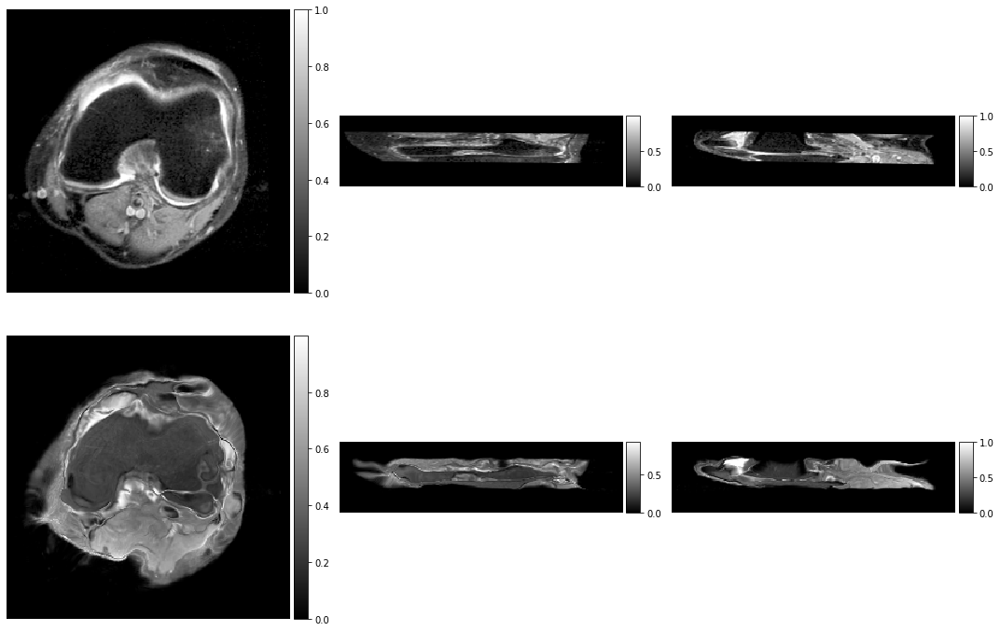

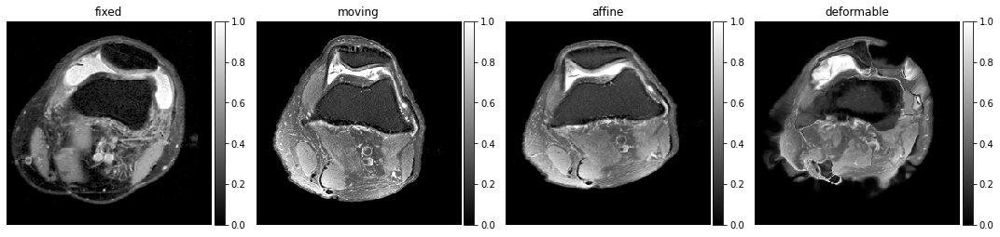

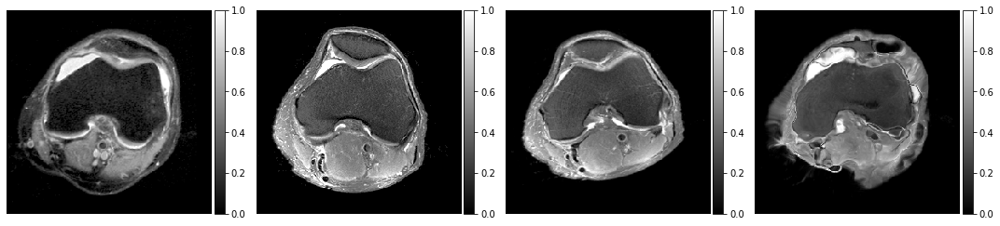

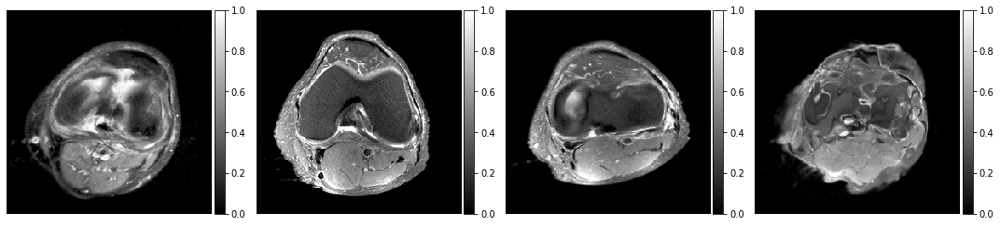

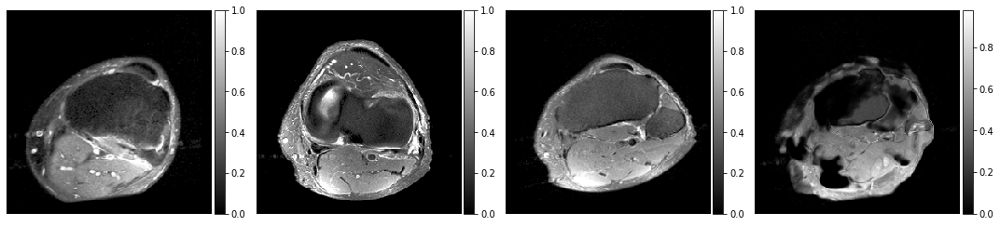

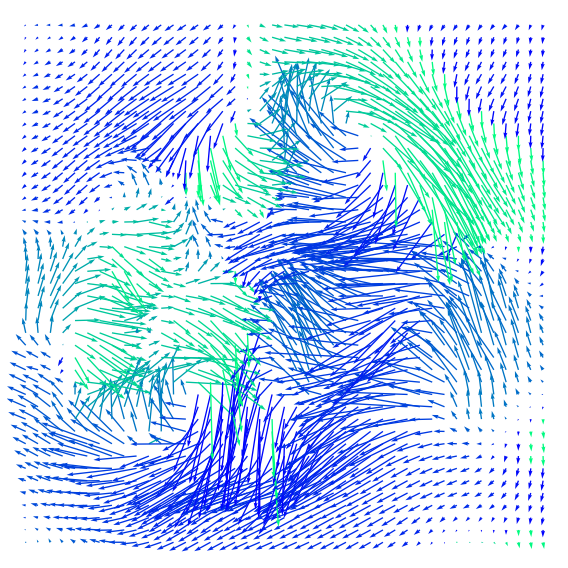

In [ ]:
cal_result_MSE(fixed_img, moving_img, warped_img, moved_pred)
visualize_fixed_and_deformed(fixed_img, moved_pred)
visualize_fixed_moving_affine_deformed(fixed_img, moving_img, warped_img, moved_pred)
visualize_disp_field(pred_disp_field, middle_slice=None, interval=3)

mse1: 0.026277706027030945, mse2: 0.027145927771925926
After affine transformation, fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)
After deformable transformation, fixed_img: (64, 256, 256) moved_pred:  (64, 256, 256)  pred_disp_field: (1, 32, 128, 128, 3)
Init MSE between fixed and moving: 0.04497335106134415
Interm. MSE between fixed and affinely wrapped: 0.026277706027030945
Final MSE between fixed and deformably wrapped: 0.007764066569507122


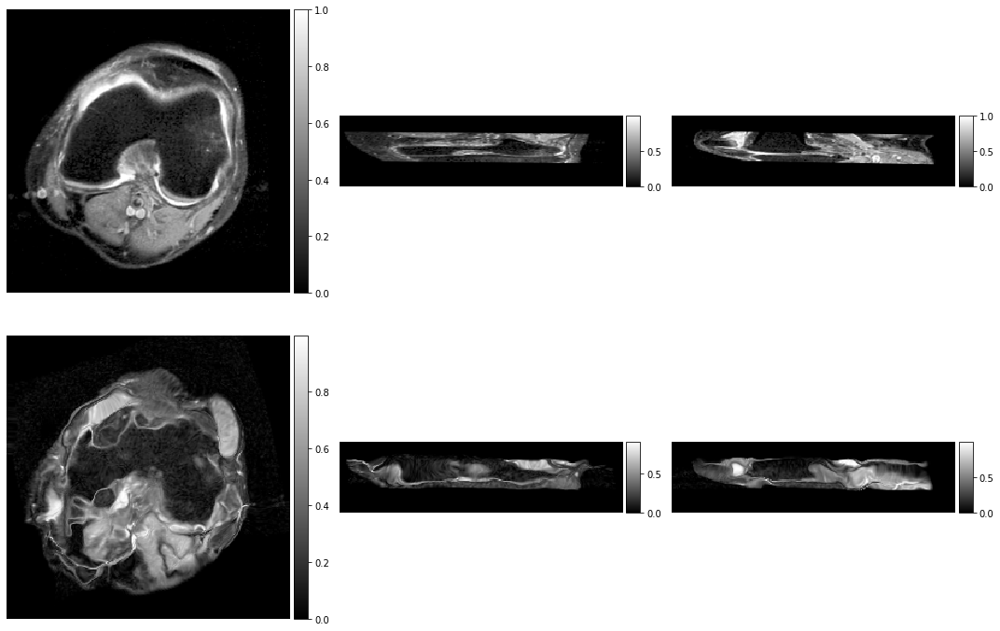

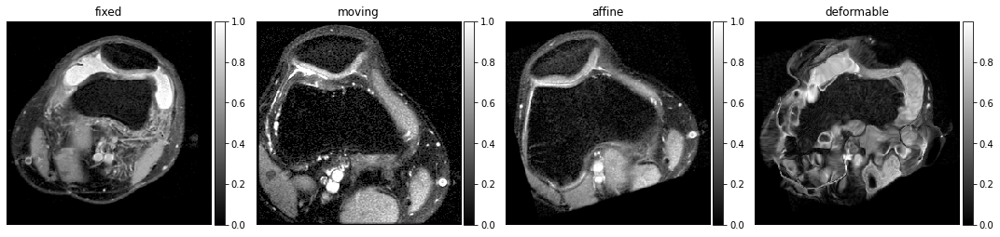

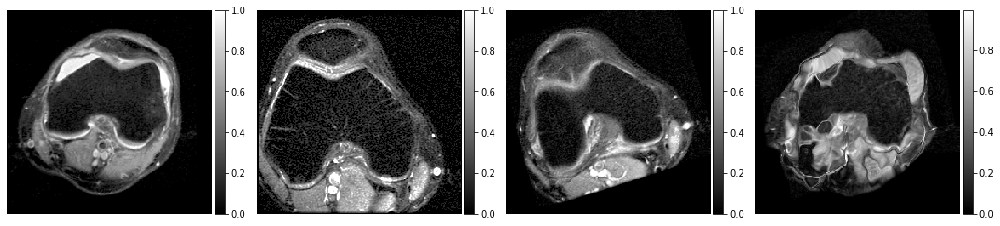

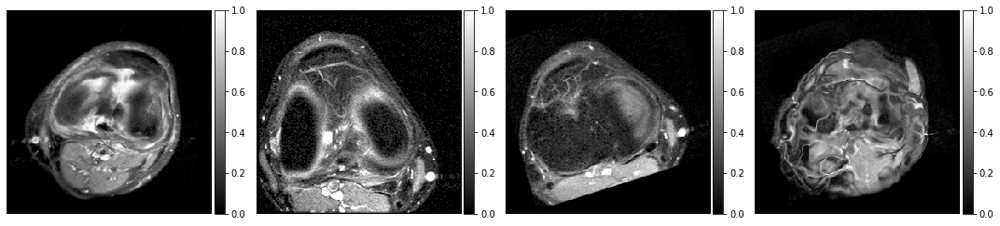

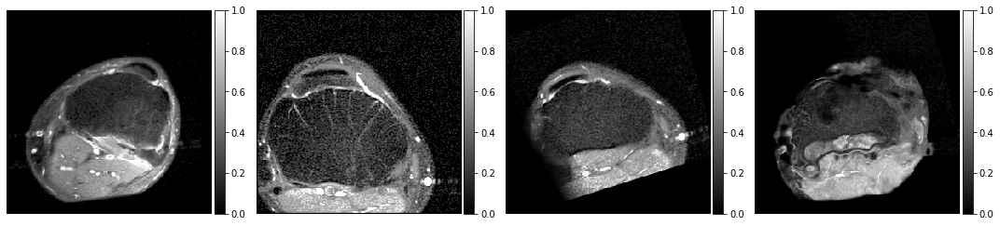

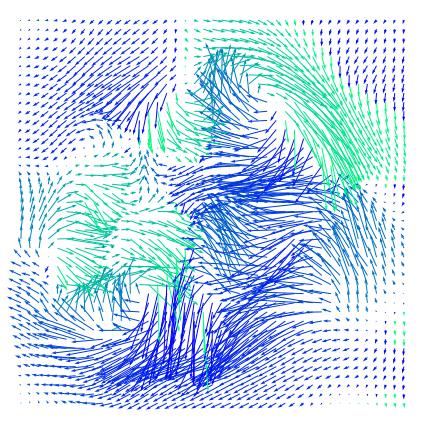

In [ ]:
# brain_T1_3D_mse
fixed_path = test_path_list[0]
# moving_path = test_path_list[120]
moving_path = test_path_list[130]
fixed_img, moving_img, warped_img, moved_pred, pred_disp_field = register_img_pair(fixed_path, moving_path, testModel, vxm_model)

cal_result_MSE(fixed_img, moving_img, warped_img, moved_pred)
visualize_fixed_and_deformed(fixed_img, moved_pred)
visualize_fixed_moving_affine_deformed(fixed_img, moving_img, warped_img, moved_pred)
visualize_disp_field(pred_disp_field, middle_slice=None, interval=3)

#### test pretrained "shape" variant synthmorph

In [ ]:
fixed_path = test_path_list[0]
moving_path = test_path_list[120]
# moving_path = test_path_list[130]
fixed_img, moving_img, warped_img, moved_pred, pred_disp_field = register_img_pair(fixed_path, moving_path, testModel, vxm_model)

mse1: 0.027061885222792625, mse2: 0.030053822323679924
After affine transformation, fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)
After deformable transformation, fixed_img: (64, 256, 256) moved_pred:  (64, 256, 256)  pred_disp_field: (1, 32, 128, 128, 3)


Init MSE between fixed and moving: 0.05738130956888199
Interm. MSE between fixed and affinely wrapped: 0.027061885222792625
Final MSE between fixed and deformably wrapped: 0.01466290932148695


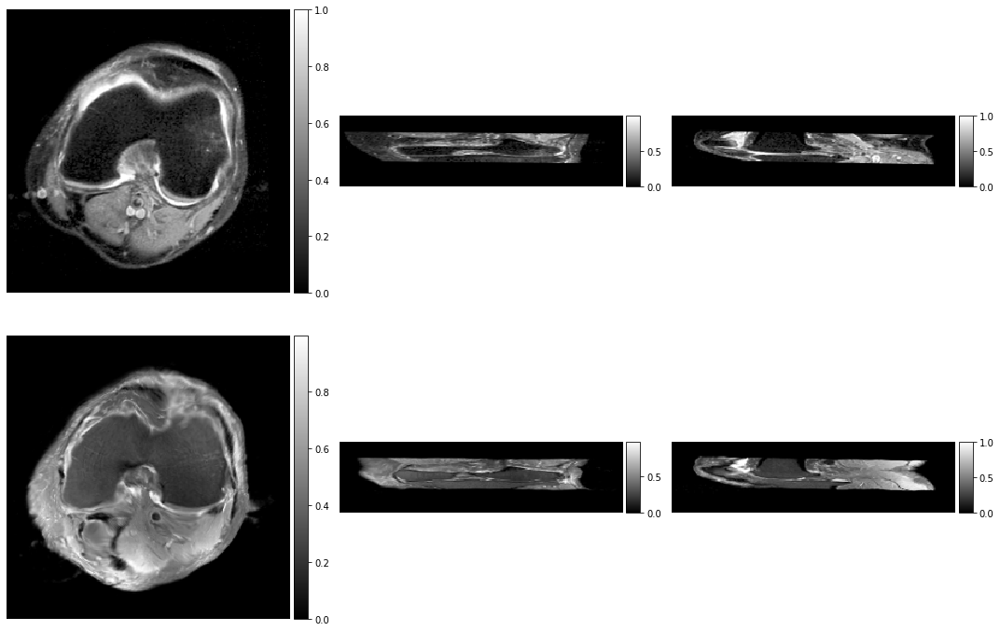

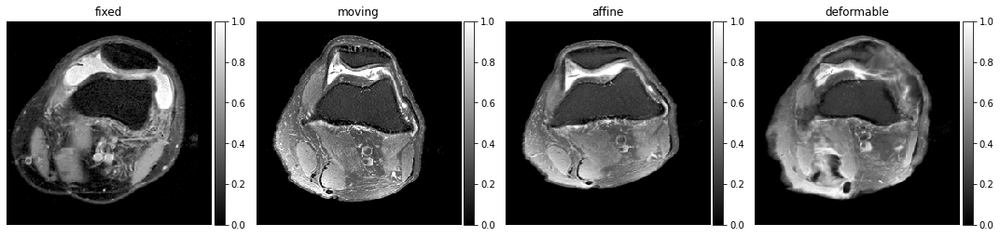

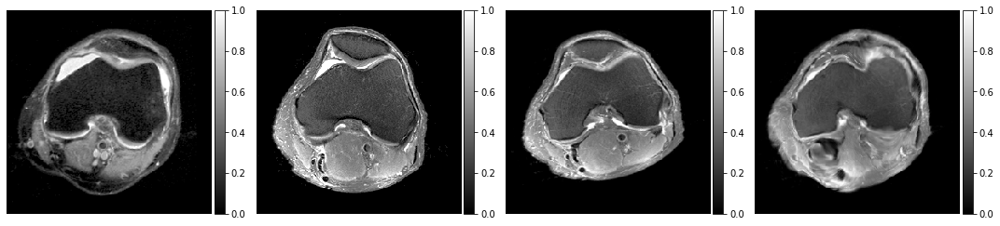

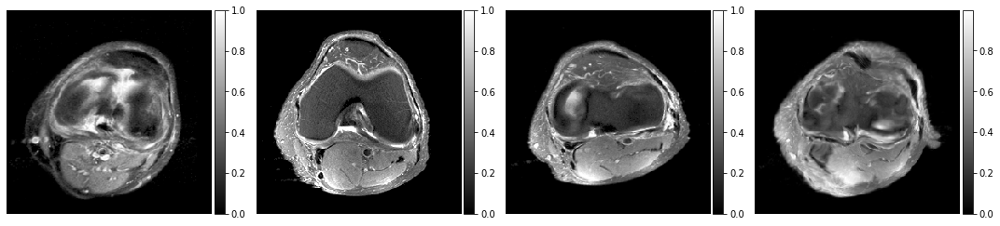

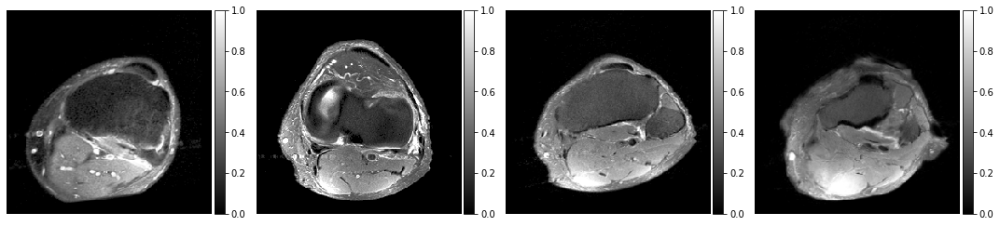

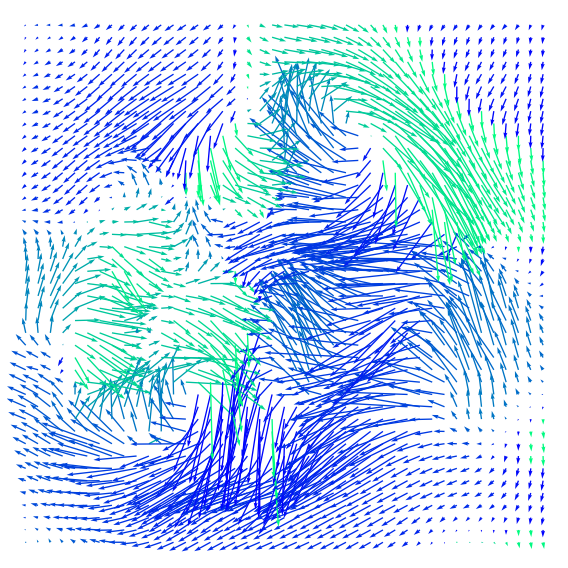

In [ ]:
cal_result_MSE(fixed_img, moving_img, warped_img, moved_pred)
visualize_fixed_and_deformed(fixed_img, moved_pred)
visualize_fixed_moving_affine_deformed(fixed_img, moving_img, warped_img, moved_pred)
visualize_disp_field(pred_disp_field, middle_slice=None, interval=3)

mse1: 0.026277706027030945, mse2: 0.027145927771925926


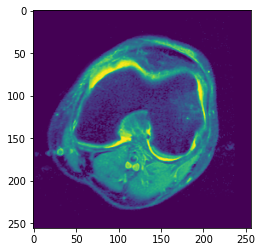

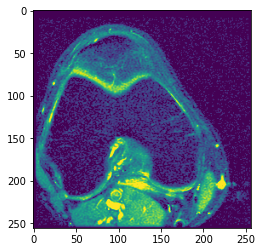

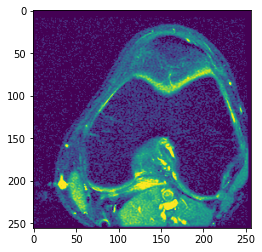

After affine transformation, fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)
After deformable transformation, fixed_img: (64, 256, 256) moved_pred:  (64, 256, 256)  pred_disp_field: (1, 32, 128, 128, 3)


In [ ]:
fixed_path = test_path_list[0]
# moving_path = test_path_list[120]
moving_path = test_path_list[130]
fixed_img, moving_img, warped_img, moved_pred, pred_disp_field = register_img_pair(fixed_path, moving_path, testModel, vxm_model, vis=True)

Init MSE between fixed and moving: 0.04497335106134415
Interm. MSE between fixed and affinely wrapped: 0.026277706027030945
Final MSE between fixed and deformably wrapped: 0.01670929417014122


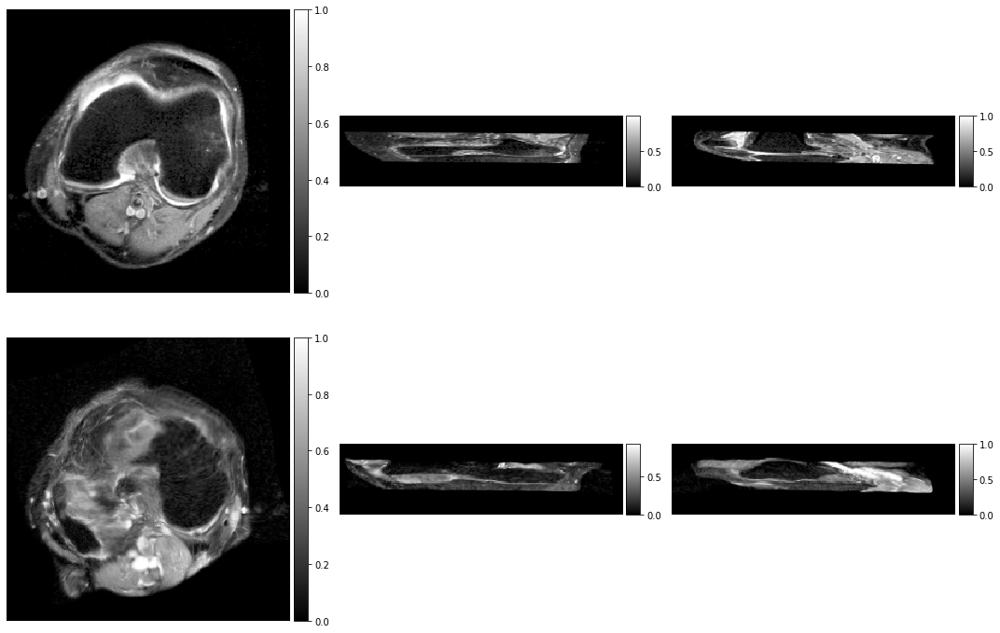

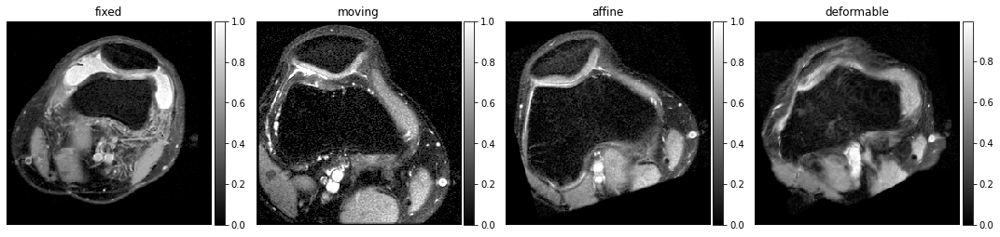

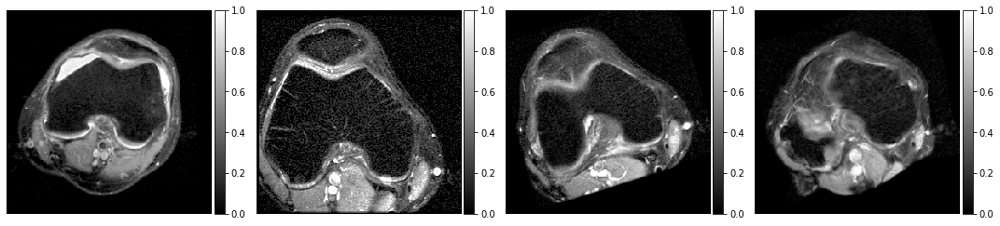

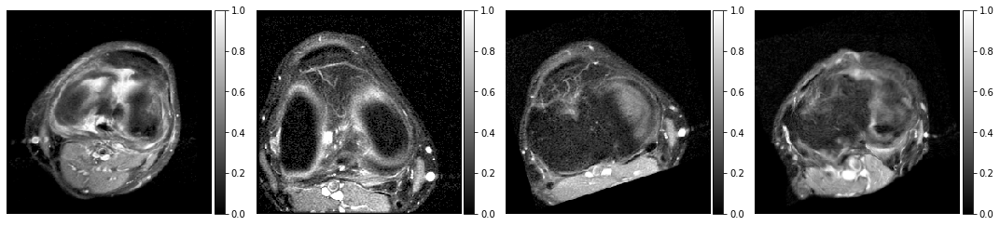

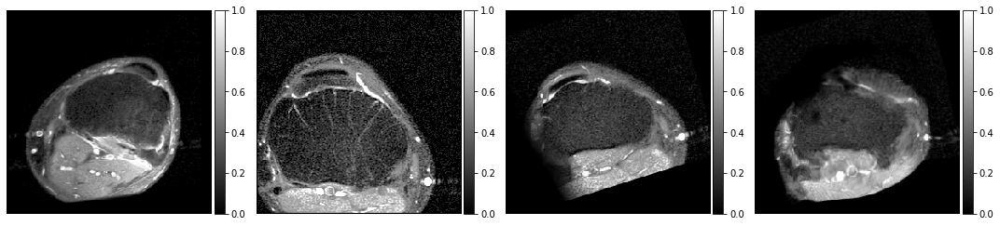

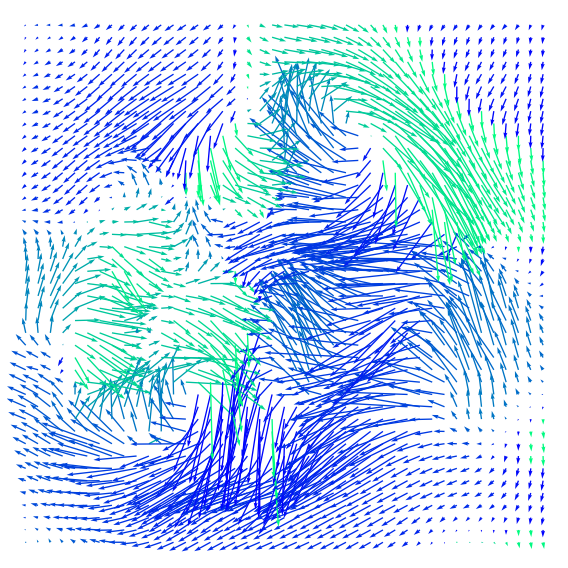

In [ ]:
cal_result_MSE(fixed_img, moving_img, warped_img, moved_pred)
visualize_fixed_and_deformed(fixed_img, moved_pred)
visualize_fixed_moving_affine_deformed(fixed_img, moving_img, warped_img, moved_pred)
visualize_disp_field(pred_disp_field, middle_slice=None, interval=3)

#### test pretrained "brain" variant synthmorph

mse1: 0.027061885222792625, mse2: 0.030053822323679924
After affine transformation, fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)
After deformable transformation, fixed_img: (64, 256, 256) moved_pred:  (64, 256, 256)  pred_disp_field: (1, 32, 128, 128, 3)
Init MSE between fixed and moving: 0.05738130956888199
Interm. MSE between fixed and affinely wrapped: 0.027061885222792625
Final MSE between fixed and deformably wrapped: 0.02024814672768116


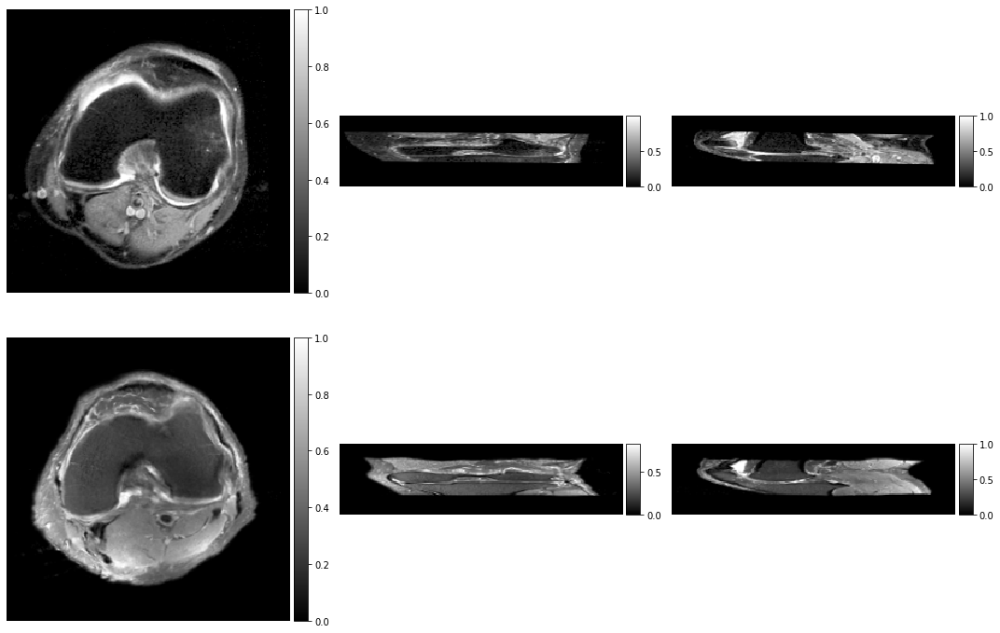

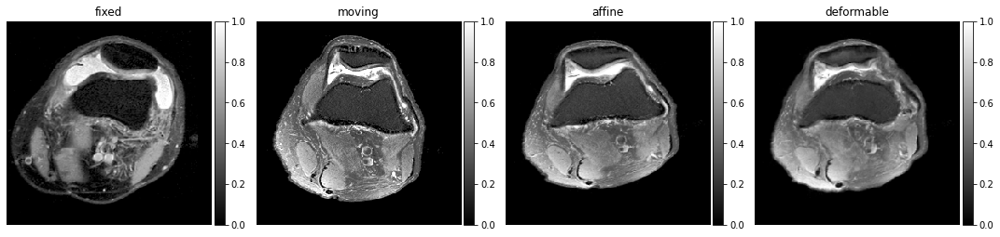

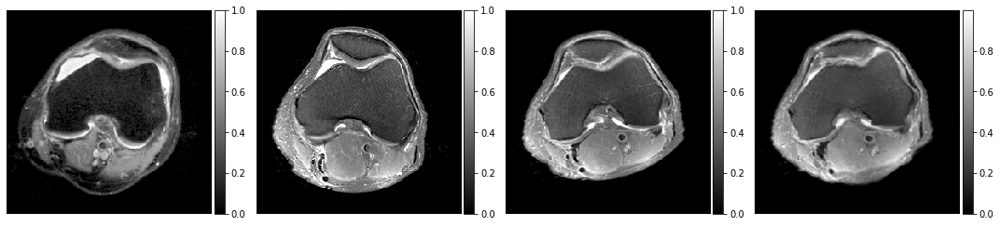

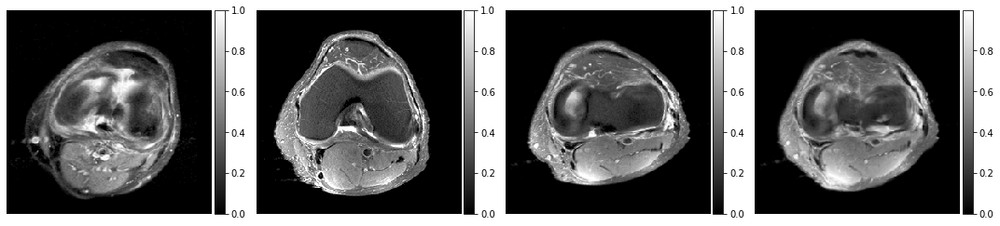

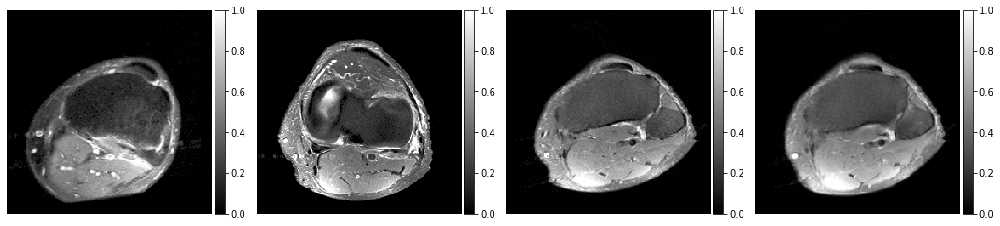

In [ ]:
fixed_path = test_path_list[0]
moving_path = test_path_list[120]
# moving_path = test_path_list[130]
fixed_img, moving_img, warped_img, moved_pred, pred_disp_field = register_img_pair(fixed_path, moving_path, testModel, vxm_model)

cal_result_MSE(fixed_img, moving_img, warped_img, moved_pred)
visualize_fixed_and_deformed(fixed_img, moved_pred)
visualize_fixed_moving_affine_deformed(fixed_img, moving_img, warped_img, moved_pred)

mse1: 0.026277706027030945, mse2: 0.027145927771925926
After affine transformation, fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)
After deformable transformation, fixed_img: (64, 256, 256) moved_pred:  (64, 256, 256)  pred_disp_field: (1, 32, 128, 128, 3)
Init MSE between fixed and moving: 0.04497335106134415
Interm. MSE between fixed and affinely wrapped: 0.026277706027030945
Final MSE between fixed and deformably wrapped: 0.021801093593239784


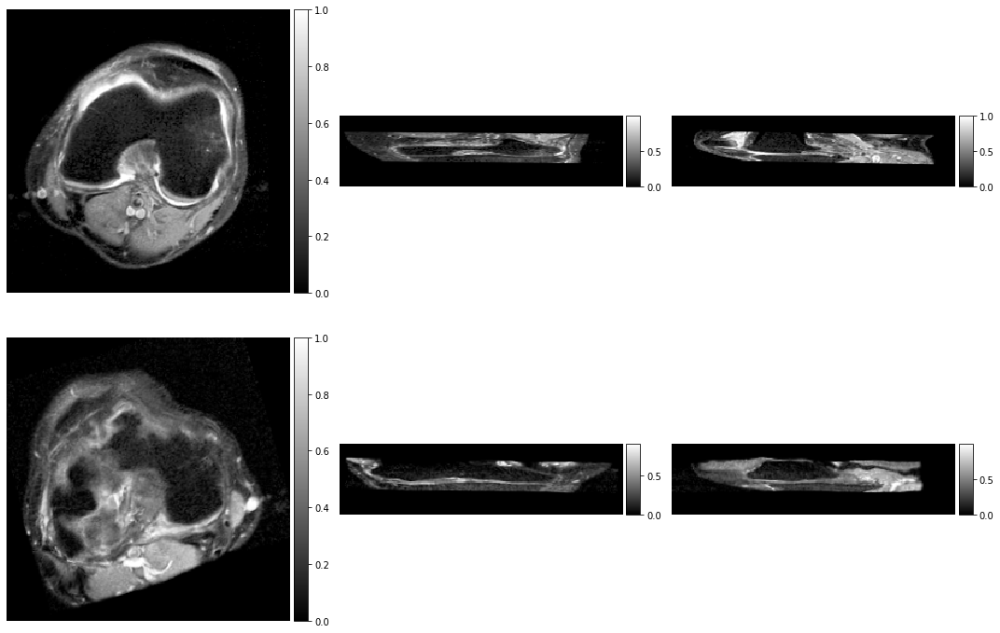

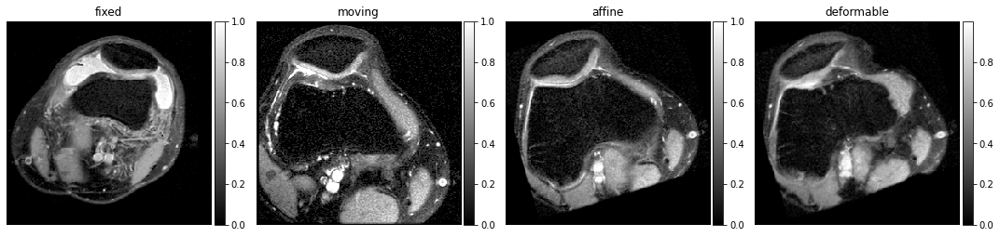

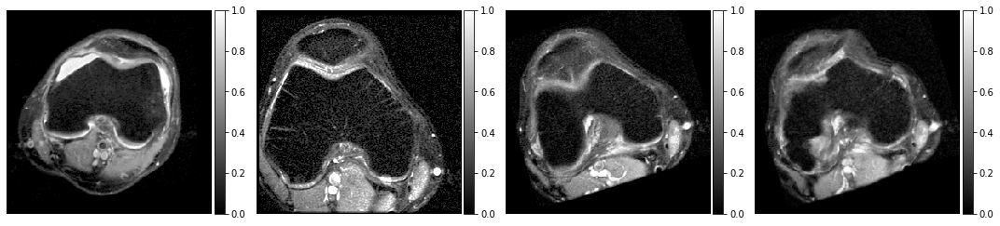

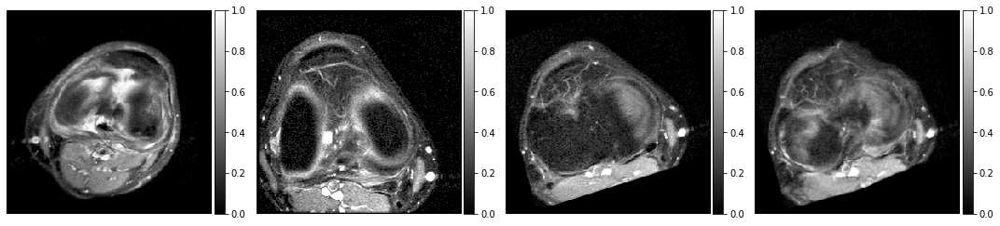

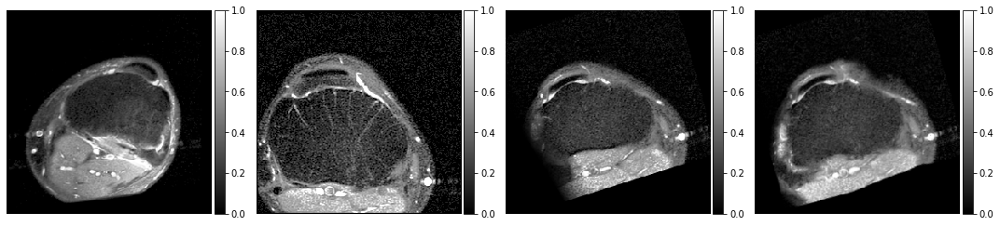

In [ ]:
fixed_path = test_path_list[0]
# moving_path = test_path_list[120]
moving_path = test_path_list[130]
fixed_img, moving_img, warped_img, moved_pred, pred_disp_field = register_img_pair(fixed_path, moving_path, testModel, vxm_model)

cal_result_MSE(fixed_img, moving_img, warped_img, moved_pred)
visualize_fixed_and_deformed(fixed_img, moved_pred)
visualize_fixed_moving_affine_deformed(fixed_img, moving_img, warped_img, moved_pred)

### scratch code to test on a single pair

In [ ]:
# ## Affine Transformation model output
# iterator = iter(msk_dataset(test_path_list, batch_size, gt_trf_key="trf_21param", train=True).get_dataset())
# moving_test, label_test = next(iterator)
# num_show = 2
# slice_num_show = 10 # >1
# slice_interval = 2
# moving_test, gt_trf = moving_test[:num_show], label_test[1][:num_show]
# (warped_test, affine_pred_test) = testModel(moving_test, training=False) # inference mode

# fixed_img_dim5 = label_test[0][0].numpy()[None, ...]
# fixed_img = fixed_img_dim5[0,...,0]
# moving_img_dim5 = moving_test[0:1, ... , 0:1].numpy()
# moving_img = moving_img_dim5[0,...,0]
# warped_img_dim5 = warped_test[0:1].numpy()
# warped_img = warped_img_dim5[0,...,0]

# print(fixed_img_dim5.shape, fixed_img.shape)
# print(moving_img_dim5.shape, moving_img.shape)
# print(warped_img_dim5.shape, warped_img.shape)

Init dataset, trf key: trf_21param, len 600
(TensorSpec(shape=(None, 64, 256, 256, 2), dtype=tf.float32, name=None), (TensorSpec(shape=(None, 64, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 21), dtype=tf.float32, name=None)))
(1, 64, 256, 256, 1) (64, 256, 256)
(1, 64, 256, 256, 1) (64, 256, 256)
(1, 64, 256, 256, 1) (64, 256, 256)


In [ ]:
# moving_test.shape, warped_test.shape

(TensorShape([2, 64, 256, 256, 2]), TensorShape([2, 64, 256, 256, 1]))

In [ ]:
## Test complete pipeline on two different images

# Affine Transformation model output (with possible flipping)
fixed_path = test_path_list[0]
moving_path = test_path_list[120]
gt_trf_key = "trf_21param"

inputObj = np.load(fixed_path)
fixed_img = inputObj["fixedImg"].astype("float32")
inputObj = np.load(moving_path)
movingImg = inputObj["movingImg"].astype("float32")
gt_trf = inputObj[gt_trf_key].astype("float32")

# get affinely wrapped img
moving_test = np.concatenate([movingImg, fixed_img], axis=4)
warped_test = affinely_wrap_img(testModel, moving_test, fixed_img)

# (warped_test, affine_pred_test) = testModel(moving_test, training=False) # inference mode
# warped_test = warped_test.numpy()
# mse = ((fixed_img - warped_test)**2).mean()

# moving_test2 = np.concatenate([movingImg[:,:,:,::-1], fixed_img], axis=4)
# (warped_test2, affine_pred_test2) = testModel(moving_test2, training=False) # inference mode
# warped_test2 = warped_test2.numpy()
# mse2 = ((fixed_img - warped_test2)**2).mean()
# print(f"mse1: {mse}, mse2: {mse2}")

# # compare mse score with fliping V.S. w/o fliping
# if mse2 < mse: # flipping initial moving image is better
#     mse = mse2
#     warped_test = warped_test2
#     affine_pred_test = affine_pred_test2
#     print("flipping initial moving img")

fixed_img_dim5 = fixed_img
fixed_img = fixed_img_dim5[0,...,0]
moving_img_dim5 = movingImg
moving_img = moving_img_dim5[0,...,0]
warped_img_dim5 = warped_test
warped_img = warped_img_dim5[0,...,0]
print("fixed_img:", fixed_img.shape, " movingImg:", movingImg.shape, " warped_test:", warped_test.shape)
# mse1: 0.027061885222792625, mse2: 0.030053822323679924
# ((64, 256, 256), (1, 64, 256, 256, 1), (1, 64, 256, 256, 1))

mse1: 0.02706189639866352, mse2: 0.030053842812776566
fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)


In [ ]:
# VoxelMorph Output
val_input = (warped_img_dim5, fixed_img_dim5)
val_pred = vxm_model.predict(val_input)

moved_pred = val_pred[0].squeeze()
pred_warp = val_pred[1] # displacement field

print(moved_pred.shape, pred_warp.shape)
# ((64, 256, 256), (1, 64, 256, 256, 3))
print("Final MSE between moved_pred and fixed_img:", MSE(moved_pred, fixed_img))

(64, 256, 256) (1, 64, 256, 256, 3)
Final MSE between moved_pred and fixed_img: 0.010047758


In [ ]:
## More succinct code to Test complete pipeline on two different images

# Affine Transformation model output (with possible flipping)
fixed_path = test_path_list[0]
moving_path = test_path_list[120]
gt_trf_key = "trf_21param"

inputObj = np.load(fixed_path)
fixed_img = inputObj["fixedImg"].astype("float32")
inputObj = np.load(moving_path)
movingImg = inputObj["movingImg"].astype("float32")
gt_trf = inputObj[gt_trf_key].astype("float32")

# get affinely wrapped img
moving_test = np.concatenate([movingImg, fixed_img], axis=4)
warped_test = affinely_wrap_img(testModel, moving_test, fixed_img)

fixed_img_dim5 = fixed_img
fixed_img = fixed_img_dim5[0,...,0]
moving_img_dim5 = movingImg
moving_img = moving_img_dim5[0,...,0]
warped_img_dim5 = warped_test
warped_img = warped_img_dim5[0,...,0]
print("After affine transformation, fixed_img:", fixed_img.shape, " movingImg:", movingImg.shape, " warped_test:", warped_test.shape)
# mse1: 0.027061885222792625, mse2: 0.030053822323679924
# ((64, 256, 256), (1, 64, 256, 256, 1), (1, 64, 256, 256, 1))

moved_pred, pred_warp = deformably_wrap_img(vxm_model, warped_img_dim5, fixed_img_dim5)
print("After deformable transformation, fixed_img:", fixed_img.shape, "moved_pred: ", moved_pred.shape, " pred_warp:", pred_warp.shape)
# ((64, 256, 256), (1, 64, 256, 256, 3))

print("Final MSE between moved_pred and fixed_img:", MSE(moved_pred, fixed_img))

mse1: 0.027061885222792625, mse2: 0.030053822323679924
After affine transformation, fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)
After deformable transformation, fixed_img: (64, 256, 256) moved_pred:  (64, 256, 256)  pred_warp: (1, 32, 128, 128, 3)
Final MSE between moved_pred and fixed_img: 0.014662909


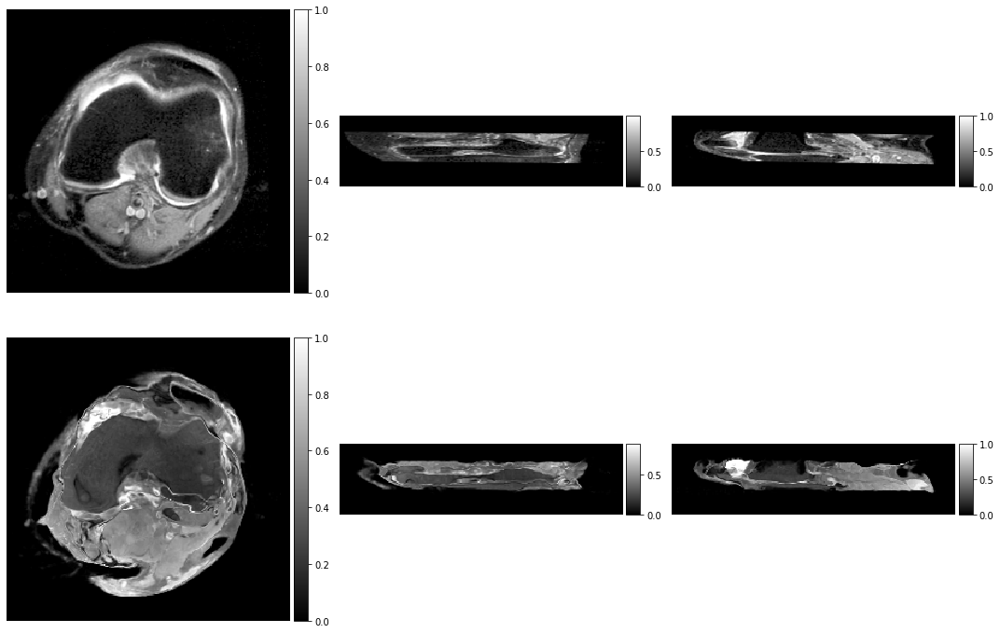

In [ ]:
## Visualize fixed & VoxelMorph warpped 3d image 
vol_shape = fixed_img.shape
mid_slices_fixed = [np.take(fixed_img, vol_shape[d]//2, axis=d) for d in range(3)]
mid_slices_pred = [np.take(moved_pred, vol_shape[d]//2, axis=d) for d in range(3)]
ne.plot.slices(mid_slices_fixed + mid_slices_pred, cmaps=['gray'], do_colorbars=True, grid=[2,3]);

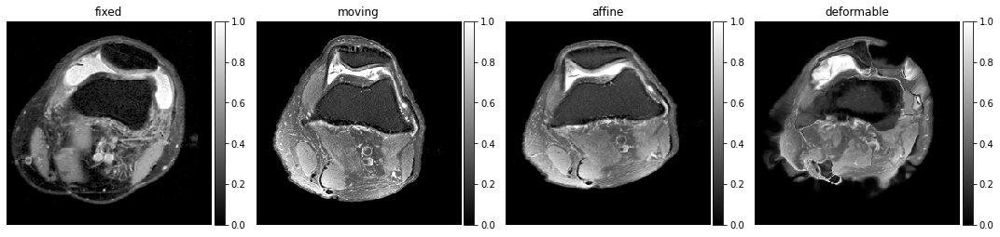

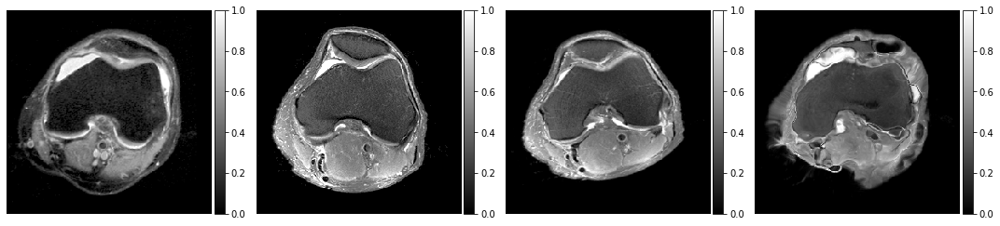

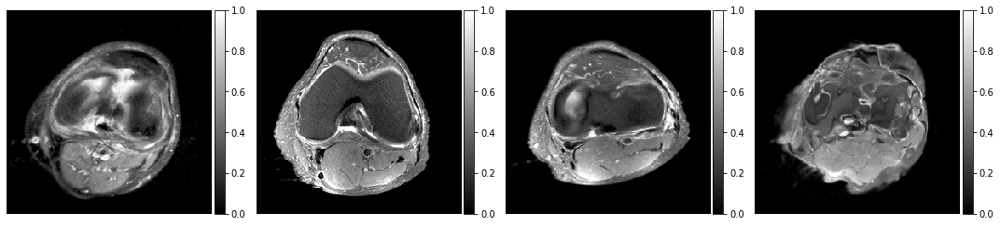

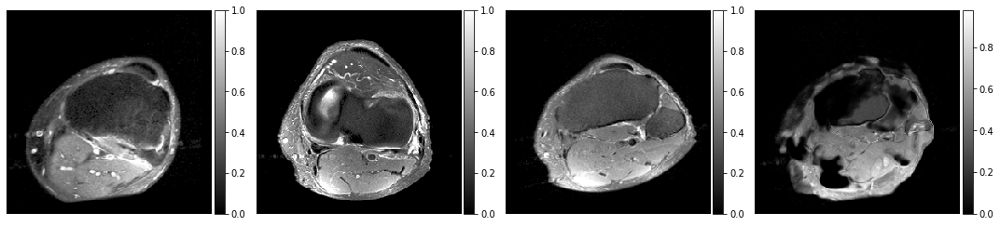

In [ ]:
## Visualize fixed, moving, affinely warped & VoxelMorph warpped image 

middle_slice_list = [25,30,35,40]
for i, middle_slice in enumerate(middle_slice_list):
# middle_slice = 30
    slices = [fixed_img[middle_slice], moving_img[middle_slice], warped_img[middle_slice], moved_pred[middle_slice]]
    if i == 0:
        ne.plot.slices(slices, titles=["fixed", "moving", "affine", "deformable"] ,cmaps=['gray'], do_colorbars=True, grid=[1,4]);
    else:
        ne.plot.slices(slices, cmaps=['gray'], do_colorbars=True, grid=[1,4]);

In [ ]:
pred_warp.shape # (1, 64, 256, 256, 3)

(1, 32, 128, 128, 3)

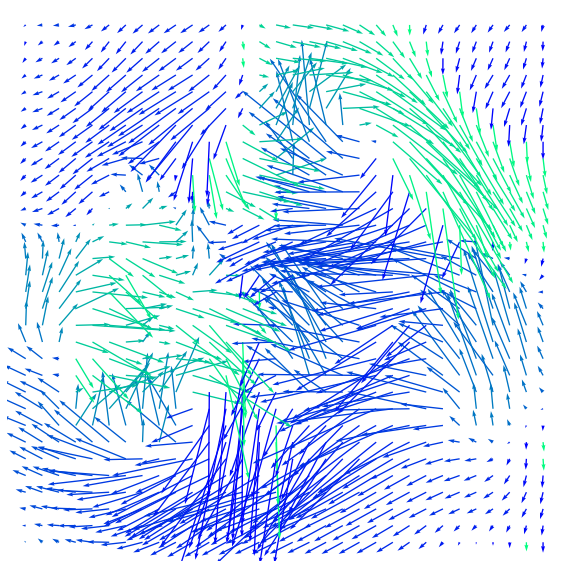

In [ ]:
# visualize flow
middle_slice = pred_warp.shape[1]//2
interval = 4
flow = pred_warp.squeeze()[middle_slice][::interval,::interval,1:]
ne.plot.flow([flow], width=8);

## Train VoxelMorph
GPU memeory: 15.75 GB required

### model summary & plot

In [ ]:
vxm_model.summary(line_length=150)

Model: "vxm_dense"
______________________________________________________________________________________________________________________________________________________
 Layer (type)                                    Output Shape                     Param #           Connected to                                      
 source_input (InputLayer)                       [(None, 64, 256, 256, 1)]        0                 []                                                
                                                                                                                                                      
 target_input (InputLayer)                       [(None, 64, 256, 256, 1)]        0                 []                                                
                                                                                                                                                      
 unet_input_concat (Concatenate)                 (None, 64, 256, 256, 2)   

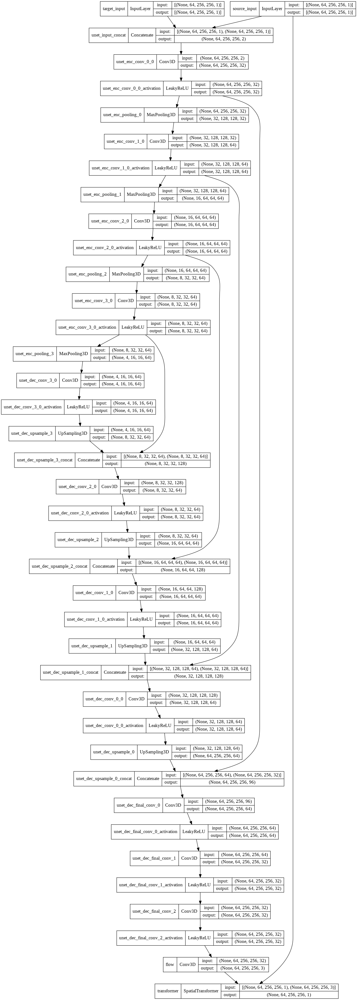

In [ ]:
keras.utils.plot_model(vxm_model, "./model_img/VoxelMorph_module.png", show_shapes=True, expand_nested=True,)

### VoxelMorph dataloader

In [ ]:
# # testModel.inputs[0]
# print('input shape: ', ', '.join([str(t.shape) for t in testModel.inputs]))
# print('output shape:', ', '.join([str(t.shape) for t in testModel.outputs]))

input shape:  (None, 64, 256, 256, 2)
output shape: (None, 64, 256, 256, 1), (None, 21)


In [19]:
def vxm_data_generator(affine_model, input_path_list:list, batch_size:int=2, gt_trf_key="trf_21param", train=True):
    """
    Generator that takes in list of images, and yields affinely transformed random 
    pair of fixed images from affine module dataloader. 
    Note that we need to provide numpy data for input and output for vxm:
        inputs:  [moving [bs, Z, H, W, 1], fixed image [bs, Z, H, W, 1]]
        outputs: [moved image [bs, Z, H, W, 1], zero-gradient [bs, Z, H, W, 2]]

    Args:
        input_path_list: list of paths to each single image
        affine_model: trained affine transformation model
        gt_trf_key:  "trf" or "trf_21param"
    Yield:
        ([movingImg, fixedImg], [fixedImg, tgtAffineTrf]) 
    """
    # use trained affine_model and affine dataset to generate data online
    affine_dataset = msk_dataset(input_path_list, batch_size, gt_trf_key=gt_trf_key, train=train).get_dataset()
    affine_dataset_iter = iter(affine_dataset)
    vol_shape = affine_model.inputs[0].shape[1:-1] # extract data shape
    ndims = len(vol_shape)

    # prepare a zero array the size of the deformation field (since not used)
    zero_phi = np.zeros([batch_size, *vol_shape, ndims])
    
    while True:
        # prepare affine outputs of the size [batch_size, H, W, 1] from fixed img (since they are further transformed)
        input_pair, _ = next(affine_dataset_iter)  # fixed as fixed
        fixed_img_dim5 = input_pair[... ,1:2]
        input_pair, _ = next(affine_dataset_iter) # fixed as moving for affine
        moving_img_dim5 = input_pair[... ,1:2]
        wrapped_img_dim5, _ = affine_model(np.concatenate([moving_img_dim5, fixed_img_dim5], axis=-1), training=False) # wrapped as moving for vxm

        inputs = [wrapped_img_dim5, fixed_img_dim5]
        outputs = [fixed_img_dim5, zero_phi]
        yield (inputs, outputs)


def vxm_data_generator_from_disk(input_path_list:list, batch_size:int=2, train=True):
    """
    Generator that takes in list of image pairs on d byisk, which are affinely wrapped
    trained affine module. 
    Note that we need to provide numpy data for input and output for vxm:
        inputs:  [moving [bs, Z, H, W, 1], fixed image [bs, Z, H, W, 1]]
        outputs: [moved image [bs, Z, H, W, 1], zero-gradient [bs, Z, H, W, 2]]

    Args:
        input_path_list: list of paths to each single image
    Yield:
        ([movingImg, fixedImg], [fixedImg, tgtAffineTrf]) 
    """
    assert input_path_list and len(input_path_list)>0
    # prepare a zero array the size of the deformation field (since not used)
    input_shape = np.load(input_path_list[0])["fixedImg"].shape[1:] #(64, 256, 256, 1)
    zero_phi = np.zeros([batch_size, *input_shape]) # a null array to match output format for tf

    length = len(input_path_list)
    ind_list = np.arange(length)
    while True:
        if train:
            ind_list = np.random.permutation(length)
        # for i in ind_list[]:
            # inputObj = np.load(input_path_list[i])
            # fixedImg = inputObj["fixedImg"].astype("float32") / 255
            # movingImg = inputObj["movingImg"].astype("float32") / 255 # affinely wrapped img
        for i in ind_list[::batch_size]:
            fixed_list = []
            moving_list = []
            for j in range(batch_size):
                inputObj = np.load(input_path_list[i + j])
                fixedImg = inputObj["fixedImg"].astype("float32") / 255
                movingImg = inputObj["movingImg"].astype("float32") / 255 # affinely wrapped img
                fixed_list.append(fixedImg)
                moving_list.append(movingImg)
            fixedImg = np.concatenate(fixed_list, axis=0)
            movingImg = np.concatenate(moving_list, axis=0)

            # prepare affine outputs of the size [batch_size, Z, H, W, 1] from real img
            inputs = [movingImg, fixedImg]
            outputs = [fixedImg, zero_phi]
            yield (inputs, outputs)

#### check dataloader

<class 'numpy.lib.npyio.NpzFile'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.lib.npyio.NpzFile'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
(2, 64, 256, 256, 1) (2, 64, 256, 256, 1) (2, 64, 256, 256, 1)


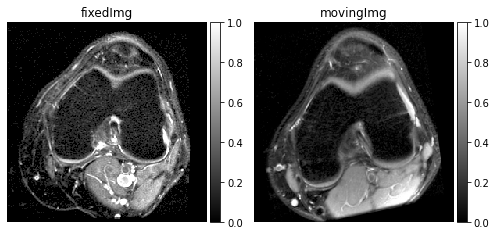

In [ ]:
sample_generator = vxm_data_generator_from_disk(vxm_val_path_list, batch_size=2, train=False)
inputs, outouts = next(sample_generator)
moving, fixed = inputs[0], inputs[1]
print(moving.shape, fixed.shape, outouts[1].shape)

# visualize
middle_slice=32
images = [fixed[0, middle_slice, :, :, 0], moving[0, middle_slice, :, :, 0]] 
titles = ['fixedImg', 'movingImg']
ne.plot.slices(images, titles=titles, cmaps=['gray'], do_colorbars=True, width=7);
plt.show()

In [ ]:
# time 1
val_generator = vxm_data_generator(affine_model, val_path_list, batch_size, gt_trf_key="trf_21param", train=True)
# %timeit -r 10 (wrapped_moving, wrapped_fixed), out_sample = next(val_generator)

num_rep = 7
time_list = []
for _ in range(num_rep):
    tick = time.time()
    (wrapped_moving, wrapped_fixed), out_sample = next(val_generator)
    time_list.append(time.time() - tick)
print(min(time_list), np.mean(time_list))

Init dataset, trf key: trf_21param, len 300
(TensorSpec(shape=(None, 64, 256, 256, 2), dtype=tf.float32, name=None), (TensorSpec(shape=(None, 64, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 21), dtype=tf.float32, name=None)))
0.782386302947998 1.4695962497166224


Init dataset, trf key: trf_21param, len 300
(TensorSpec(shape=(None, 64, 256, 256, 2), dtype=tf.float32, name=None), (TensorSpec(shape=(None, 64, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 21), dtype=tf.float32, name=None)))


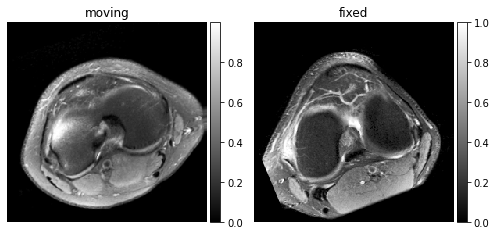

0.03980069


In [ ]:
# check
val_generator = vxm_data_generator(affine_model, val_path_list, batch_size, gt_trf_key="trf_21param", train=True)
(wrapped_moving, fixed), out_sample = next(val_generator)
middle_slice = affine_model.inputs[0].shape[1] // 2

# visualize
images = [wrapped_moving[0, middle_slice, :, :, 0].numpy(), fixed[0, middle_slice, :, :, 0].numpy()] 
titles = ['moving', 'fixed']
ne.plot.slices(images, titles=titles, cmaps=['gray'], do_colorbars=True, width=7);
print(MSE(wrapped_moving.numpy(), fixed.numpy()))

### Train

In [ ]:
## Define vxm dataset path
vxm_train_data_dir = "./data/affinelyWrappedData/train" #affine{}.npz
vxm_val_data_dir = "./data/affinelyWrappedData/val"
vxm_test_data_dir = "./data/affinelyWrappedData/test"
vxm_val_size = 40 # 300
vxm_test_size = 300 # 300
batch_size = 1

vxm_train_path_list = os.listdir(vxm_train_data_dir)
vxm_train_path_list = [os.path.join(vxm_train_data_dir, item) for item in vxm_train_path_list]
vxm_val_path_list = os.listdir(vxm_val_data_dir)
vxm_val_path_list = [os.path.join(vxm_val_data_dir, item) for item in vxm_val_path_list]
# val_path_list = val_path_list[:val_size]
vxm_test_path_list = os.listdir(vxm_test_data_dir)
vxm_test_path_list = [os.path.join(vxm_test_data_dir, item) for item in vxm_test_path_list]
# test_path_list = test_path_list[:test_size]

len(vxm_train_path_list), len(vxm_val_path_list), len(vxm_test_path_list)

(4000, 300, 300)

In [ ]:
## online dataloader
# train_vxm_generator = vxm_data_generator(affine_model, train_path_list, batch_size, gt_trf_key="trf_21param", train=True)
# val_vxm_generator = vxm_data_generator(affine_model, val_path_list, batch_size, gt_trf_key="trf_21param", train=True)

## offine dataloader
train_vxm_generator = vxm_data_generator_from_disk(vxm_train_path_list, batch_size=batch_size, train=True)
val_vxm_generator = vxm_data_generator_from_disk(vxm_val_path_list, batch_size=batch_size, train=True) # allow some randomness in val data

In [ ]:
# configure unet features 
inshape = (64,256,256)
nb_features = [ ## unet features, same as the pretrained
    [16, 32, 32, 32],
    [32, 32, 32, 32, 32, 16, 16]
]
## doubled feature for subject-to-subject registration as the "VoxelMorph x2 (MSE)" in paper
multiply_factor = 1
nb_features = [
    [multiply_factor * i for i in nb_features[0]],
    [multiply_factor * i for i in nb_features[1]]
]

vxm_model = vxm.networks.VxmDense(inshape, nb_features, int_steps=0)

print('input shape: ', ', '.join([str(t.shape) for t in vxm_model.inputs]))
print('output shape:', ', '.join([str(t.shape) for t in vxm_model.outputs]))

Instructions for updating:
Use fn_output_signature instead
input shape:  (None, 64, 256, 256, 1), (None, 64, 256, 256, 1)
output shape: (None, 64, 256, 256, 1), (None, 64, 256, 256, 3)


In [ ]:
## Training parameters
experiment_name = "VoxelMorph_on_wrapped_data"
output_dir = os.path.join("checkpoints", experiment_name, time.strftime("%m_%d_%H-%M-%S"))

# Optimizer 
lr = 0.0005 # 0001
optimizer = tf.keras.optimizers.Adam(learning_rate = lr)

# voxelmorph custom loss classes
losses = [vxm.losses.MSE().loss, vxm.losses.Grad('l2').loss]
lambda_param = 0.05 # balance the two losses by a hyper-parameter
loss_weights = [1, lambda_param]

vxm_model.compile(optimizer=optimizer, loss=losses, loss_weights=loss_weights)

## callbacks for training
save_callback = ModelCheckpoint(os.path.join(output_dir, "{epoch:02d}.h5"),
                # monitor='val_warped_image_mean_squared_error',
                 save_best_only=True,
                 )
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5,
                patience=7, min_lr=0.000005)
resume_training = False

batch_size, output_dir

(1, 'checkpoints/VoxelMorph_on_wrapped_data/02_08_14-26-47')

In [15]:
## only for resuming training
output_dir = "checkpoints/VoxelMorph_on_wrapped_data/02_08_14-26-47"
which_model = "29"
vxm_model = keras.models.load_model(f"{output_dir}/{which_model}.h5", custom_objects={
    "vxm_dense": vxm.tf.modelio.LoadableModel,
    "transformer": vxm.layers.SpatialTransformer,
    "VxmDense": vxm.networks.VxmDense,
    "loss": [vxm.losses.MSE().loss, vxm.losses.Grad('l2').loss] # vxm custom loss
})

save_callback = ModelCheckpoint(os.path.join(output_dir, "{epoch:02d}.h5"),
                                # monitor='val_warped_image_mean_squared_error',
                                save_best_only=True,
                                )
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5,
                              patience=7, min_lr=0.000005)

In [16]:
# epochs = 10
# steps_per_epoch = 5
# val_steps = 2
# initial_epoch = 0
# validation_freq = 1

# batch_size=1 -> 1.6s/sample,  each epoch (400+50) takes ≈ 0.2h, 30 epochs ≈6 hours 
epochs = 45
steps_per_epoch = 200
val_steps = 30
# steps_per_epoch = 400
# val_steps = 50
validation_freq = 1
initial_epoch = 29

## 3s/sample, (150+20)*20 = 3400 ≈ 1h, 
# epochs = 20 * 5
# steps_per_epoch = 150
# val_steps = 20
# validation_freq = 1
# initial_epoch = 0
results = vxm_model.fit(train_vxm_generator, epochs=epochs, steps_per_epoch=steps_per_epoch, verbose=2,
                     validation_data=val_vxm_generator, validation_steps=val_steps, 
                     validation_freq=validation_freq, callbacks=[save_callback, reduce_lr], 
                     initial_epoch=initial_epoch,
                    #  workers=2,  # 
                    )

if not os.path.exists(output_dir): # in case the save_callback did not save any weights
    os.makedirs(output_dir)
print("save output_dir:", output_dir, "\n")
vxm_model.save(os.path.join(output_dir, "final_model.h5"))
with open(os.path.join(output_dir, "results.pkl"), "wb") as f:
    pickle.dump(results.history, f)

Epoch 30/45
200/200 - 347s - loss: 0.0177 - transformer_loss: 0.0136 - flow_loss: 0.0816 - val_loss: 0.0148 - val_transformer_loss: 0.0112 - val_flow_loss: 0.0717 - lr: 5.0000e-04 - 347s/epoch - 2s/step
Epoch 31/45
200/200 - 345s - loss: 0.0167 - transformer_loss: 0.0129 - flow_loss: 0.0762 - val_loss: 0.0159 - val_transformer_loss: 0.0118 - val_flow_loss: 0.0818 - lr: 5.0000e-04 - 345s/epoch - 2s/step
Epoch 32/45
200/200 - 347s - loss: 0.0162 - transformer_loss: 0.0124 - flow_loss: 0.0759 - val_loss: 0.0161 - val_transformer_loss: 0.0122 - val_flow_loss: 0.0771 - lr: 5.0000e-04 - 347s/epoch - 2s/step
Epoch 33/45
200/200 - 355s - loss: 0.0170 - transformer_loss: 0.0131 - flow_loss: 0.0786 - val_loss: 0.0169 - val_transformer_loss: 0.0125 - val_flow_loss: 0.0868 - lr: 5.0000e-04 - 355s/epoch - 2s/step
Epoch 34/45
200/200 - 344s - loss: 0.0164 - transformer_loss: 0.0126 - flow_loss: 0.0765 - val_loss: 0.0146 - val_transformer_loss: 0.0110 - val_flow_loss: 0.0719 - lr: 5.0000e-04 - 344s/e

### Evaluate

In [17]:
 def plot_loss(history, ylim=None, val_freq=1, start_epoch=0):
    loss_length = len(history['loss'])
    plt.plot(range(start_epoch, start_epoch+loss_length), history['loss'])
    if val_freq==1:
        plt.plot(range(start_epoch, start_epoch+loss_length), history['val_loss'])
    else:
        plt.plot(range(start_epoch, start_epoch+loss_length, val_freq), history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    if ylim:
        plt.ylim(ylim)
    plt.legend(['train', 'val'])
    plt.show()

def plot_accuracy(history, metric_name="warped_image_mean_squared_error", val_freq=1, start_epoch=0):
    assert metric_name in history and "val_"+metric_name in history, "history doesn't contain such metric"
    metric_length = len(history[metric_name])
    plt.plot(range(start_epoch, start_epoch+metric_length), history[metric_name])
    if val_freq==1:
        plt.plot(range(start_epoch, start_epoch+metric_length), history['val_' + metric_name])
    else:
        plt.plot(range(start_epoch, start_epoch+metric_length, val_freq), history['val_' + metric_name])
    
    plt.title(f"Train and val {metric_name}")
    plt.ylabel(metric_name)
    plt.xlabel('epoch')
    plt.legend(['train', 'val']) #, loc='upper left'
    plt.show()

#### Trial 2: Voxelmorph on new offline dataset
* Train on data generated before hands
* weight = [1, 0.05]

In [49]:
# Load model and result
experiment_name = "VoxelMorph_on_wrapped_data"
model_date_time = "02_08_14-26-47"
which_model = "44"

output_dir = f"checkpoints/{experiment_name}/{model_date_time}"
vxm_mdl_path = f"{output_dir}/{which_model}.h5"

test_vxm_model = keras.models.load_model(vxm_mdl_path, custom_objects={
    "vxm_dense": vxm.tf.modelio.LoadableModel,
    "transformer": vxm.layers.SpatialTransformer,
    "VxmDense": vxm.networks.VxmDense,
    "loss": [vxm.losses.MSE().loss, vxm.losses.Grad('l2').loss] # vxm custom loss
})

test_vxm_model.inputs

[<KerasTensor: shape=(None, 64, 256, 256, 1) dtype=float32 (created by layer 'source_input')>,
 <KerasTensor: shape=(None, 64, 256, 256, 1) dtype=float32 (created by layer 'target_input')>]

In [32]:
steps = vxm_test_size//batch_size

# test_vxm_generator = vxm_data_generator(affine_model, vxm_test_path_list, batch_size, gt_trf_key="trf_21param", train=False)
test_vxm_generator = vxm_data_generator_from_disk(vxm_test_path_list, batch_size=batch_size, train=False)
test_vxm_model.evaluate(x=test_vxm_generator, steps=steps, return_dict=True)

300/300 [==============================] - 163s 540ms/step - loss: 0.0163 - transformer_loss: 0.0123 - flow_loss: 0.0817


{'flow_loss': 0.08168148994445801,
 'loss': 0.016335325315594673,
 'transformer_loss': 0.012251246720552444}

test sample: ./data/affinelyWrappedData/test/wrapped_moving27_fixed54.npz
After deformable transformation, fixed_img: (1, 64, 256, 256, 1)  movingImg: (1, 64, 256, 256, 1) moved_pred:  (1, 64, 256, 256, 1)  pred_disp_field: (1, 64, 256, 256, 3)
Init MSE between fixed and moving: 0.0447811558842659
Final MSE between fixed and deformably wrapped: 0.009755070321261883


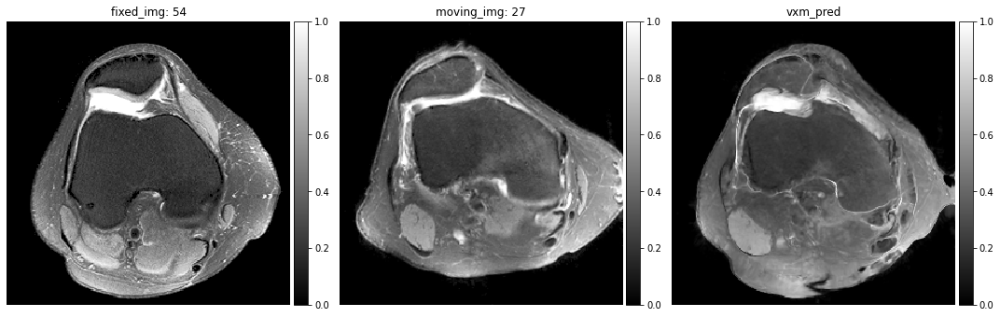

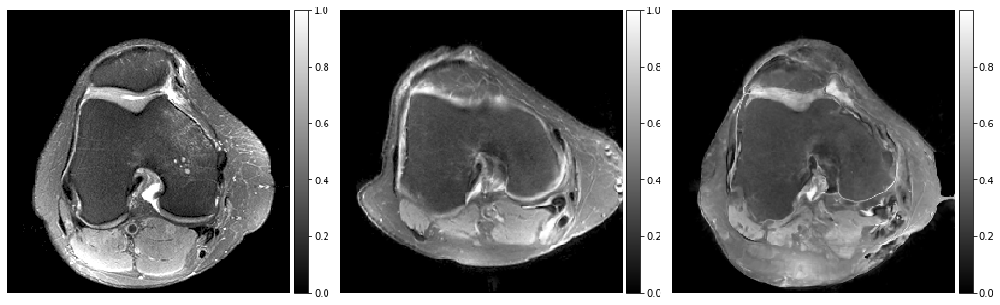

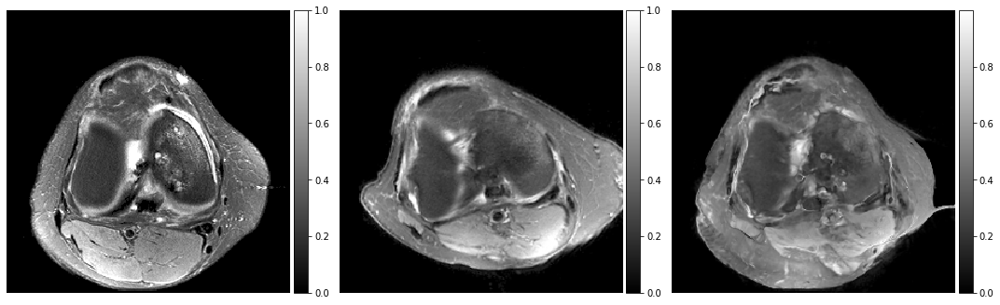

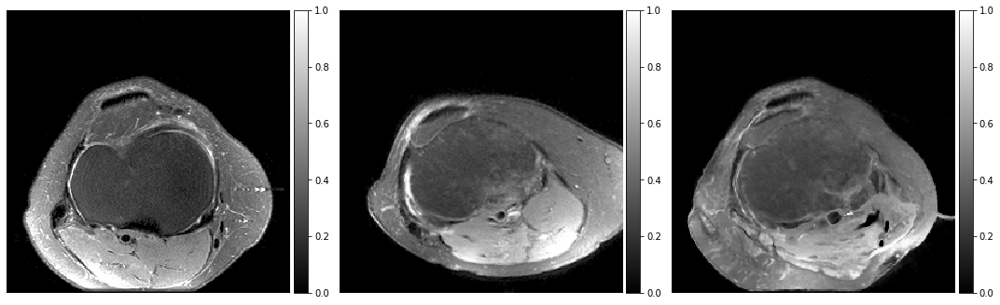

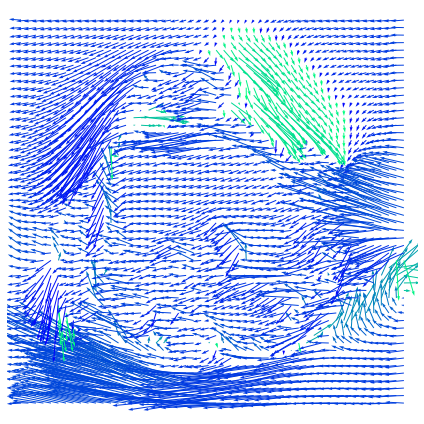

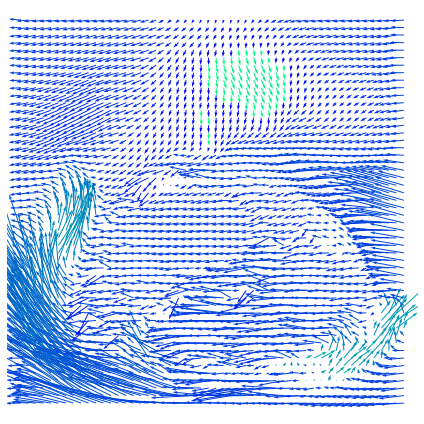

In [72]:
test_path = vxm_test_path_list[0]
print("test sample:", test_path)
moving_name = test_path.split("_moving")[-1].split("_fixed")[0]
fixed_name = test_path.split("_fixed")[-1].split(".npz")[0]
# moving_path = vxm_test_path_list[80]
fixed_img, moving_img, moved_pred, pred_disp_field = register_fixed_and_affinely_wrapped(fixed_path, test_path)

# print and visualize result
cal_result_MSE(fixed_img, moving_img, moved_pred=moved_pred)
# visualize_fixed_and_deformed(fixed_img, moved_pred)
# visualize_fixed_moving_affine_deformed(fixed_img, moving_img, warped_img, moved_pred)
visualize_3D_image_list([fixed_img, moving_img, moved_pred], middle_slice_list=[25,30,35,40], 
                        titles=[f"fixed_img: {fixed_name}", f"moving_img: {moving_name}", "vxm_pred"])
visualize_disp_field(pred_disp_field, middle_slice=[25,45], interval=5)

test sample: ./data/affinelyWrappedData/test/wrapped_moving54_fixed27.npz
After deformable transformation, fixed_img: (1, 64, 256, 256, 1)  movingImg: (1, 64, 256, 256, 1) moved_pred:  (1, 64, 256, 256, 1)  pred_disp_field: (1, 64, 256, 256, 3)
Init MSE between fixed and moving: 0.0447811558842659
Final MSE between fixed and deformably wrapped: 0.009755070321261883


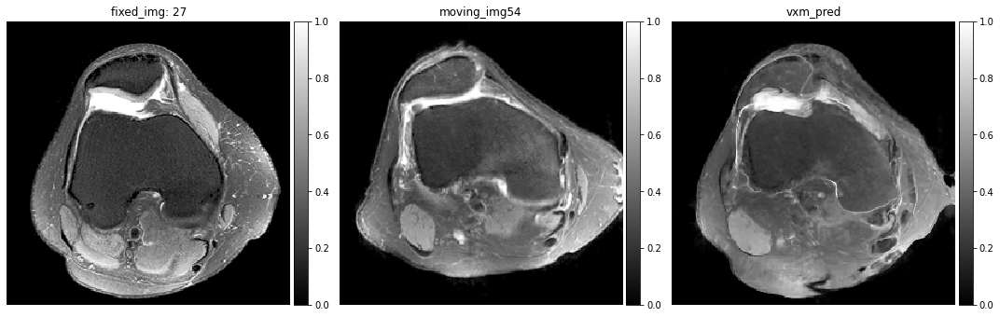

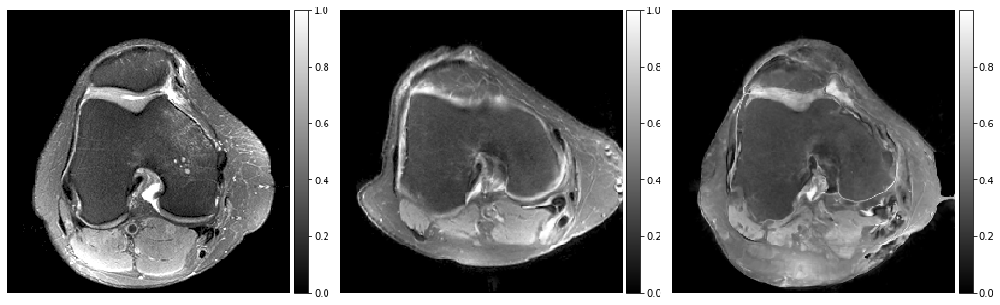

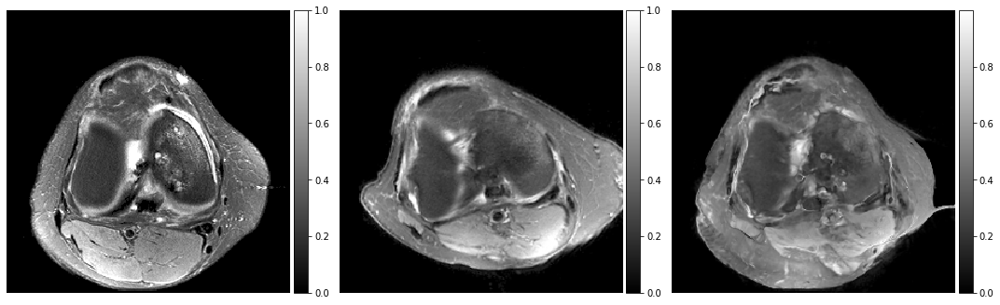

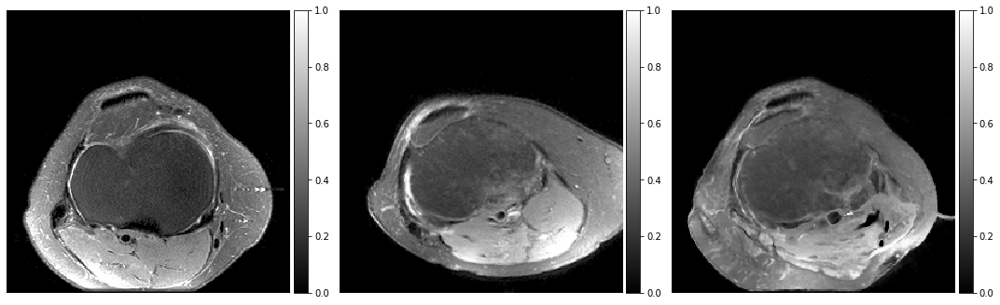

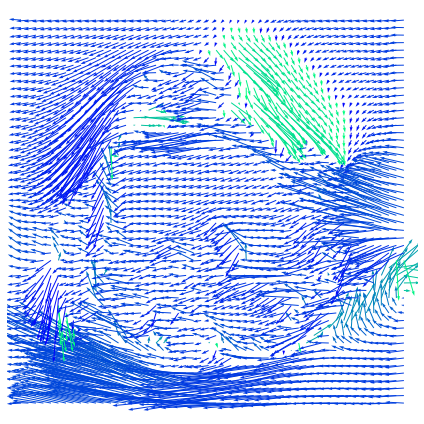

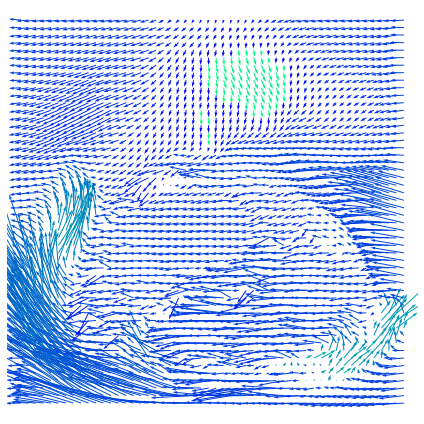

In [70]:
test_path = vxm_test_path_list[1]
print("test sample:", test_path)
moving_name = test_path.split("_moving")[-1].split("_fixed")[0]
fixed_name = test_path.split("_fixed")[-1].split(".npz")[0]
# moving_path = vxm_test_path_list[80]
fixed_img, moving_img, moved_pred, pred_disp_field = register_fixed_and_affinely_wrapped(fixed_path, test_path)

# print and visualize result
cal_result_MSE(fixed_img, moving_img, moved_pred=moved_pred)
# visualize_fixed_and_deformed(fixed_img, moved_pred)
# visualize_fixed_moving_affine_deformed(fixed_img, moving_img, warped_img, moved_pred)
visualize_3D_image_list([fixed_img, moving_img, moved_pred], middle_slice_list=[25,30,35,40], 
                        titles=[f"fixed_img: {fixed_name}", f"moving_img: {moving_name}", "vxm_pred"])
visualize_disp_field(pred_disp_field, middle_slice=[25,45], interval=5)

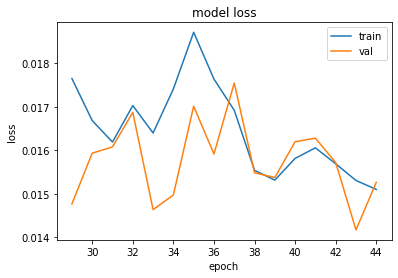

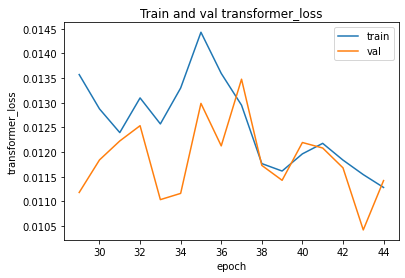

In [59]:
## 
# history = load_pickle(osp.join(output_dir, "results.pkl"))
history = results.history
start_epoch = 29
val_freq = 1
plot_loss(history, ylim=None, val_freq=val_freq, start_epoch=start_epoch)
plot_accuracy(history, metric_name="transformer_loss", val_freq=val_freq, start_epoch=start_epoch)

#### Trial 1: VoxelMorph on online dataset
* use online dataloader
* weight = [1, 0.05]

In [77]:
# Load model and result
experiment_name = "VoxelMorph_dataV3_21param"
model_date_time = "02_02_02-13-17"
which_model = "final_model"

output_dir = f"checkpoints/{experiment_name}/{model_date_time}"
vxm_mdl_path = f"{output_dir}/{which_model}.h5"

test_vxm_model = keras.models.load_model(vxm_mdl_path, custom_objects={
    "vxm_dense": vxm.tf.modelio.LoadableModel,
    "transformer": vxm.layers.SpatialTransformer,
    "VxmDense": vxm.networks.VxmDense,
    "loss": [vxm.losses.MSE().loss, vxm.losses.Grad('l2').loss] # vxm custom loss
})

### load as vxm.networks.VxmDense.load, but the returned model is not compiled (),
### which is needed for evaluation, and need to respecify loss weight
# test_vxm_model = load_voxelmorph(vxm_mdl_path, inshape=None) 
# # Compile with optimizer and loss for 
# lr = 0.001 # 0001
# optimizer = tf.keras.optimizers.Adam(learning_rate = lr)
# losses = [vxm.losses.MSE().loss, vxm.losses.Grad('l2').loss]
# lambda_param = 0.05 # balance the two losses by a hyper-parameter
# loss_weights = [1, lambda_param]
# vxm_model.compile(optimizer=optimizer, loss=losses, loss_weights=loss_weights)

test_vxm_model.inputs

[<KerasTensor: shape=(None, 64, 256, 256, 1) dtype=float32 (created by layer 'source_input')>,
 <KerasTensor: shape=(None, 64, 256, 256, 1) dtype=float32 (created by layer 'target_input')>]

In [ ]:
# test_vxm_model = vxm_model

In [ ]:
steps = test_size//batch_size

test_vxm_generator = vxm_data_generator(affine_model, test_path_list, batch_size, gt_trf_key="trf_21param", train=False)
test_vxm_model.evaluate(x=test_vxm_generator, steps=steps, return_dict=True)

Init dataset, trf key: trf_21param, len 300
(TensorSpec(shape=(None, 64, 256, 256, 2), dtype=tf.float32, name=None), (TensorSpec(shape=(None, 64, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 21), dtype=tf.float32, name=None)))
300/300 [==============================] - 514s 2s/step - loss: 0.0092 - transformer_loss: 0.0066 - flow_loss: 0.0533


{'flow_loss': 0.05330941453576088,
 'loss': 0.009231762029230595,
 'transformer_loss': 0.006566290277987719}

After affine transformation, fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)
After deformable transformation, fixed_img: (64, 256, 256) moved_pred:  (64, 256, 256)  pred_disp_field: (1, 64, 256, 256, 3)
Init MSE between fixed and moving: 0.05655725672841072
Interm. MSE between fixed and affinely wrapped: 0.020068420097231865
Final MSE between fixed and deformably wrapped: 0.006273411214351654


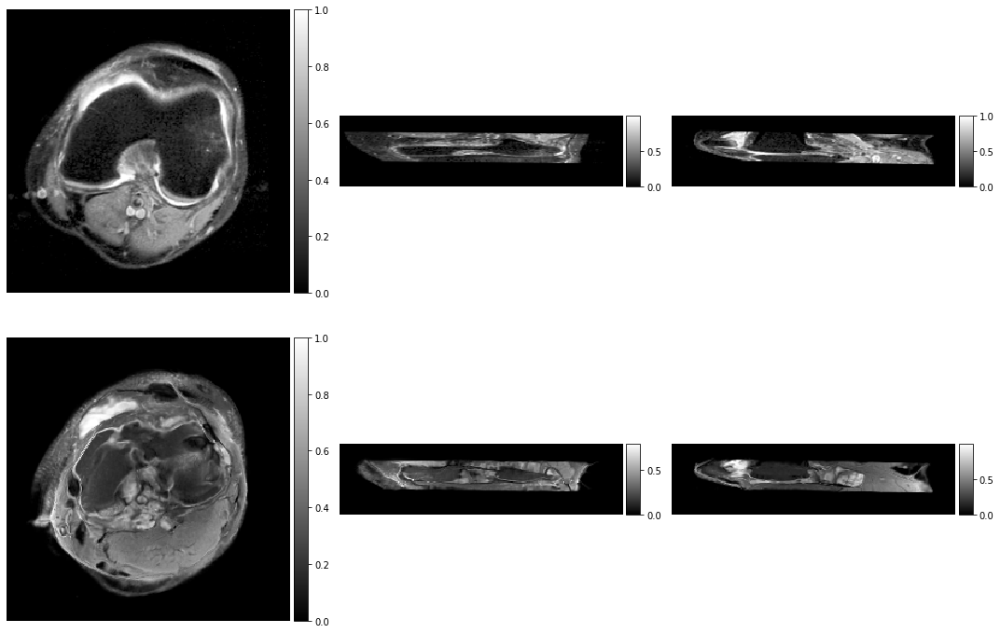

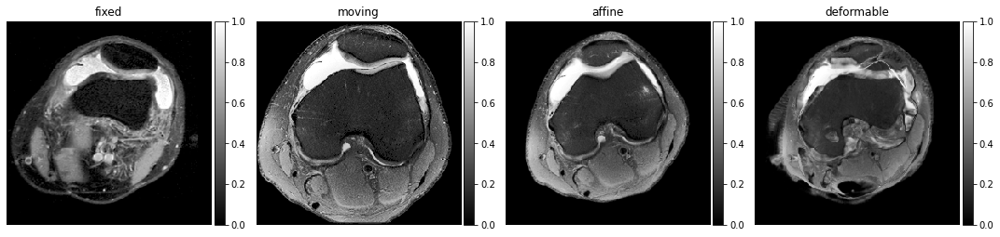

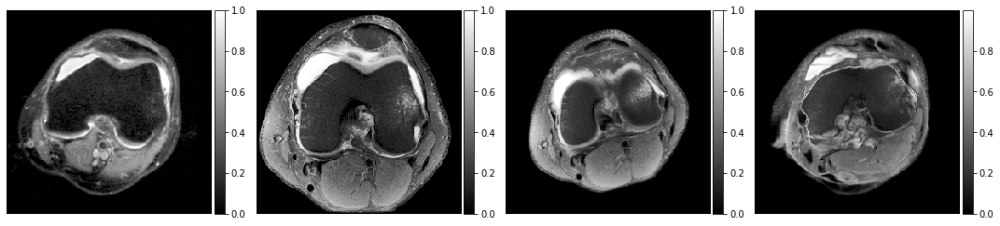

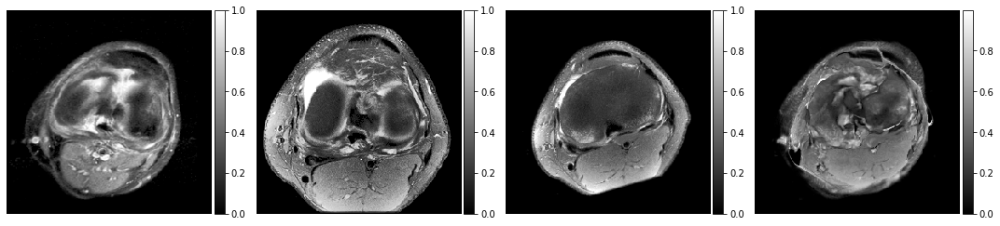

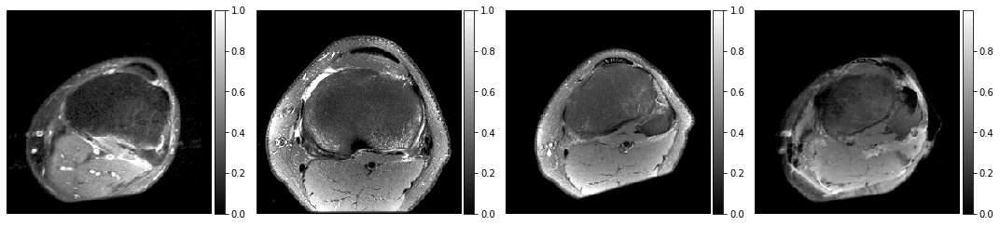

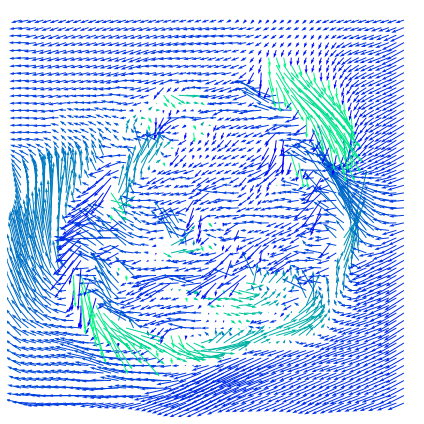

In [ ]:
fixed_path = test_path_list[0]
moving_path = test_path_list[80]
# moving_path = test_path_list[130]
fixed_img, moving_img, warped_img, moved_pred, pred_disp_field = register_img_pair(fixed_path, moving_path, affine_model, test_vxm_model)

# print and visualize result
cal_result_MSE(fixed_img, moving_img, warped_img=warped_img, moved_pred=moved_pred)
visualize_fixed_and_deformed(fixed_img, moved_pred)
visualize_fixed_moving_affine_deformed(fixed_img, moving_img, warped_img, moved_pred)
visualize_disp_field(pred_disp_field, middle_slice=None, interval=5)

After affine transformation, fixed_img: (64, 256, 256)  movingImg: (1, 64, 256, 256, 1)  warped_test: (1, 64, 256, 256, 1)
After deformable transformation, fixed_img: (64, 256, 256) moved_pred:  (64, 256, 256)  pred_disp_field: (1, 64, 256, 256, 3)
Init MSE between fixed and moving: 0.04497335106134415
Interm. MSE between fixed and affinely wrapped: 0.026277706027030945
Final MSE between fixed and deformably wrapped: 0.006403745152056217


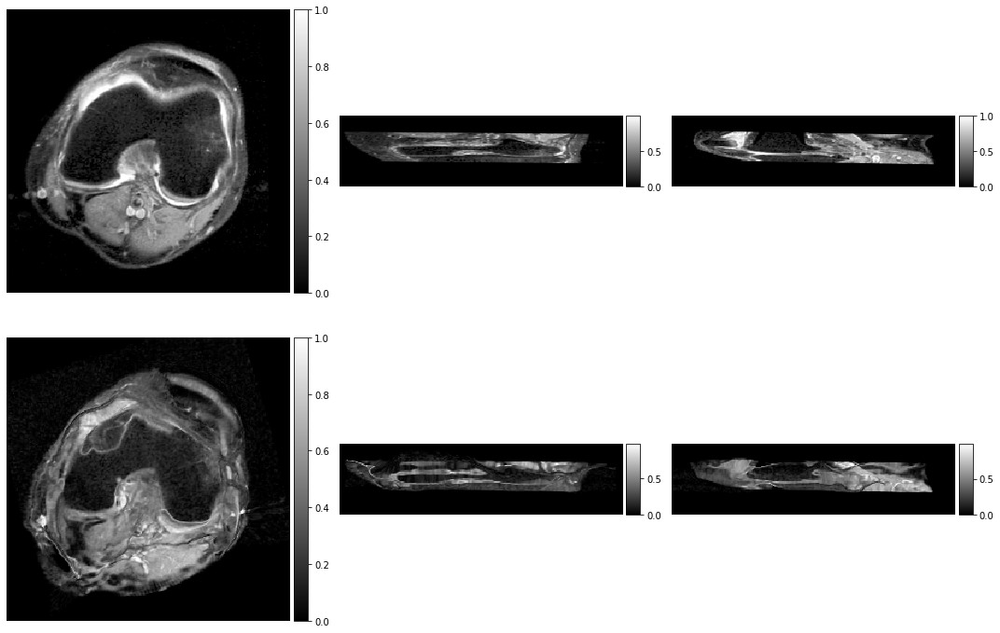

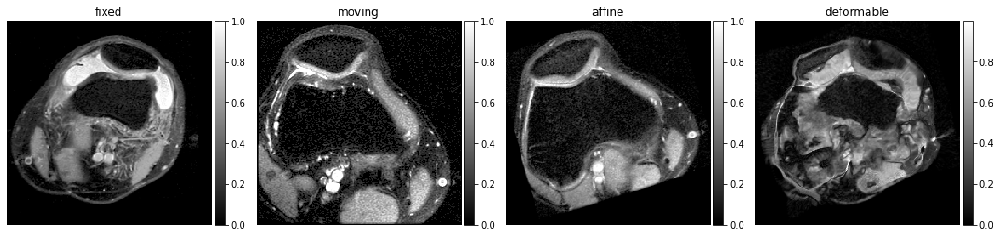

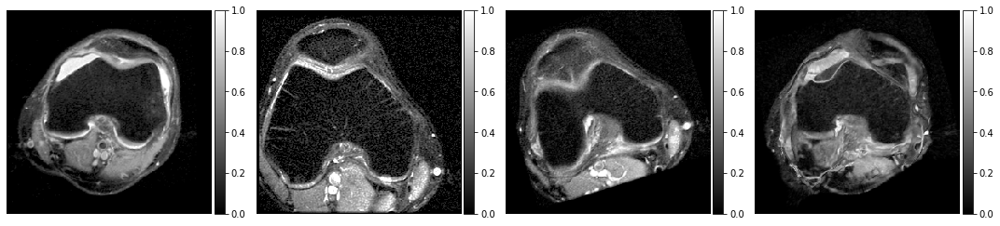

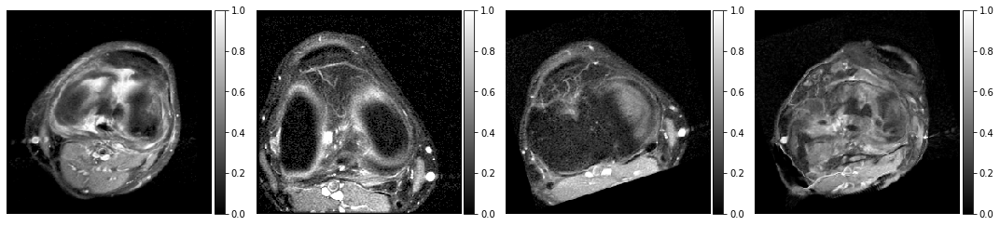

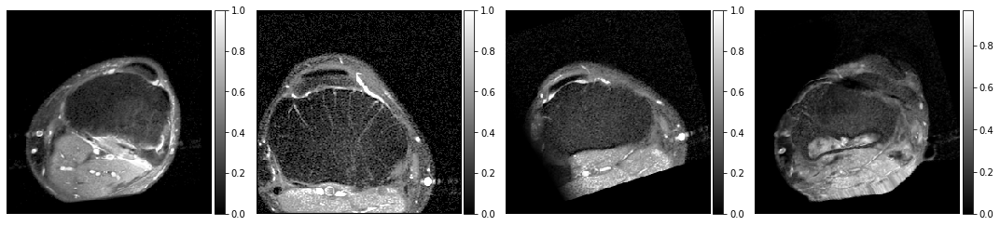

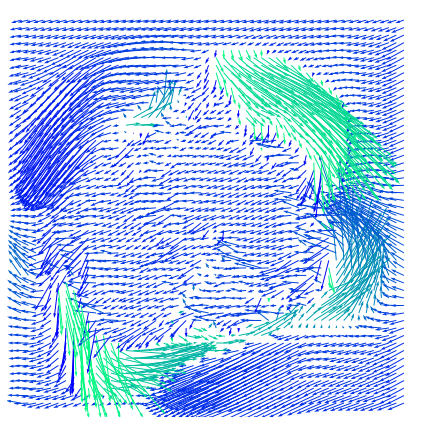

In [80]:
fixed_path = test_path_list[0]
# moving_path = test_path_list[80]
moving_path = test_path_list[130]
fixed_img, moving_img, warped_img, moved_pred, pred_disp_field = register_img_pair(fixed_path, moving_path, affine_model, test_vxm_model)

# print and visualize result
cal_result_MSE(fixed_img, moving_img, warped_img=warped_img, moved_pred=moved_pred)
visualize_fixed_and_deformed(fixed_img, moved_pred)
visualize_fixed_moving_affine_deformed(fixed_img, moving_img, warped_img, moved_pred)
visualize_disp_field(pred_disp_field, middle_slice=None, interval=5)

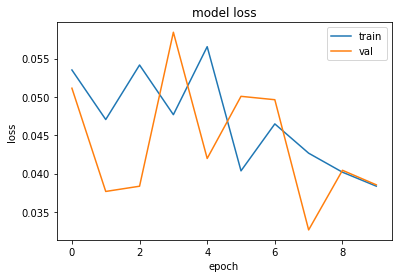

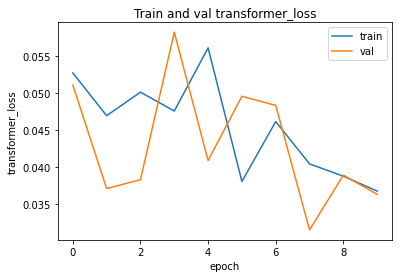

In [ ]:
## 
# history = load_pickle(osp.join(output_dir, "results.pkl"))
history = results.history
plot_loss(history, ylim=None, val_freq=1, start_epoch=0)
plot_accuracy(history, metric_name="transformer_loss", val_freq=1, start_epoch=0)